In [8]:
from picaso import justdoit as jdi 
from picaso import justplotit as jpi

jpi.output_notebook()

opa = jdi.opannection(wave_range=[0.3,1])
cannedCJ = jdi.inputs()

Loading BokehJS ...

# Canned CJ

In [9]:
# Set full phase:
cannedCJ.phase_angle(0)
# set gravity:
cannedCJ.gravity(gravity=25, gravity_unit=jdi.u.Unit('m/(s**2)'))
# set star:
cannedCJ.star(opa, 6000,0.0122,4.437)
# set atm to Jupiter's PT profile:
cannedCJ.atmosphere(filename = jdi.jupiter_pt(), delim_whitespace=True)
# set clouds to Jupiter's clouds:
cannedCJ.clouds(filename = jdi.jupiter_cld(), delim_whitespace=True)

# get the full output from the spectrum:
df = cannedCJ.spectrum(opa, full_output=True) #note the new last key 
cannedCJwno, cannedCJalb, cannedCJfull_output = df['wavenumber'] , df['albedo'] , df['full_output'] 

In [33]:
cannedCJ.inputs

{'version': 3.1,
 'calculation': 'spectrum_only',
 'phase': 0,
 'planet': {'gravity': 2500.0,
  'gravity_unit': 'cm/(s**2)',
  'radius': nan,
  'radius_unit': 'Radius not specified',
  'mass': nan,
  'mass_unit': 'Mass not specified'},
 'climate': {'t_table': None,
  'p_table': None,
  'grad': None,
  'cp': None,
  'ntemp_bb_grid': 2400,
  'dt_bb_grid': 2.5,
  'guess_temp': None,
  'pressure': None,
  'nstr': None,
  'nofczns': None,
  'rfacv': None,
  'rfaci': None,
  'cloudy': None,
  'mh': None,
  'Cto': None,
  'cld_species': None},
 'star': {'database': 'ck04models',
  'temp': 6000,
  'metal': 0.0122,
  'logg': 4.437,
  'radius': nan,
  'radius_unit': 'Radius not supplied',
  'flux': array([3.72738238e+14, 3.72943402e+14, 3.73148586e+14, ...,
         4.28624385e+14, 4.28420977e+14, 4.28217549e+14]),
  'wno': array([10000.41805245, 10001.41814426, 10002.41833609, ...,
         33325.63422262, 33328.96695267, 33332.30001602]),
  'semi_major': nan,
  'semi_major_unit': 'Semi Major a

<IPython.core.display.Javascript object>


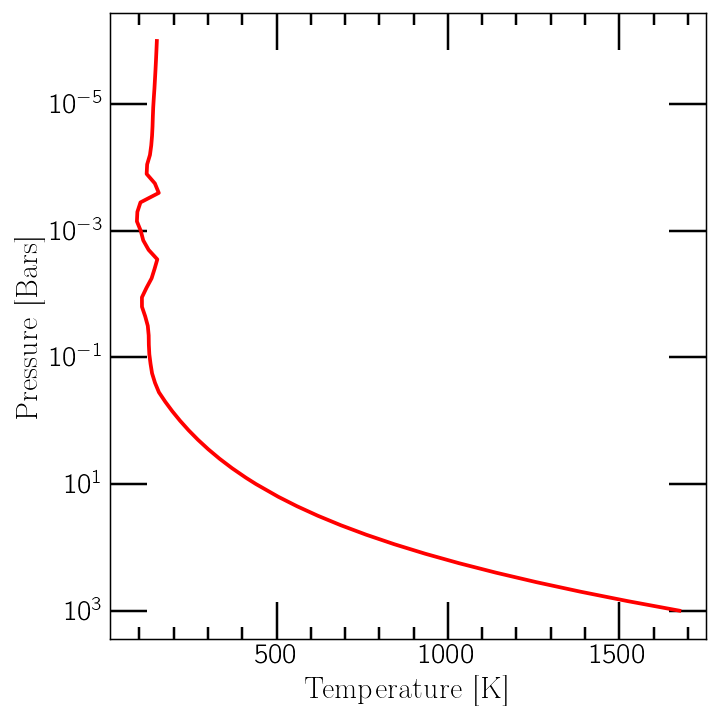

In [30]:
#### Plot PT profile:
plt.figure(figsize=(8,8))
plt.ylabel("Pressure [Bars]", fontsize=25)
plt.xlabel('Temperature [K]', fontsize=25)
plt.gca().invert_yaxis()
#plt.ylim(500,1e-4)
#plt.xlim(200,3000)

plt.semilogy(full_output['level']['temperature'],
             full_output['level']['pressure'],color="r",linewidth=3,label="Our Run")

plt.minorticks_on() 
plt.tick_params(axis='both',which='major',length =30, width=2,direction='in',labelsize=23)
plt.tick_params(axis='both',which='minor',length =10, width=2,direction='in',labelsize=23)

#plt.legend(fontsize=15)

#plt.title(r"T$_{\rm eff}$= "+str(Teq)+" K, log(g)= "+\
##          str(np.round(cl_wj.inputs['planet']['gravity']/100, decimals=2))\
 #         +r" m s$^{-2}$",fontsize=25)

plt.tight_layout()

In [24]:
cannedCJ.inputs['atmosphere']['profile'].keys()

Index(['pressure', 'temperature', 'e-', 'H2', 'H', 'H+', 'H-', 'VO', 'TiO',
       'CO2', 'He', 'H2O', 'CH4', 'CO', 'NH3', 'N2', 'PH3'],
      dtype='object')

<IPython.core.display.Javascript object>


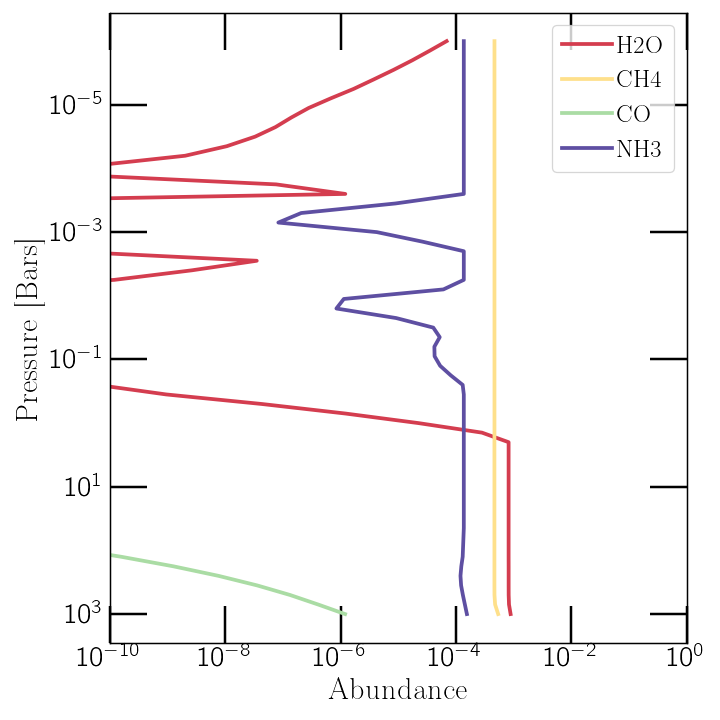

In [31]:
#mols = ['H2O','CH4','CO','NH3']
mols = ['H2O','CH4','CO','NH3']

#### Use 'ptchem_df' output from climate model, which contains the chemical structure of the
# computed climate.

%matplotlib notebook

import matplotlib

cmap = matplotlib.cm.get_cmap('Spectral')

n = len(mols)
cs = np.linspace(0.1,1,n)
colors = cmap(cs)

#colors = 

plt.figure(figsize=(8,8))
plt.minorticks_on()
plt.tick_params(axis='both',which='major',length =30, width=2,direction='in',labelsize=23)
plt.tick_params(axis='both',which='minor',length =10, width=2,direction='in',labelsize=23)

plt.ylabel("Pressure [Bars]", fontsize=25)
plt.xlabel('Abundance', fontsize=25)
plt.gca().invert_yaxis()
#plt.ylim(500,1e-4)
plt.xlim(left=1e-10)

for i,mol in enumerate(mols):
    plt.plot(cannedCJ.inputs['atmosphere']['profile'][mol],
             cannedCJ.inputs['atmosphere']['profile']['pressure'],
             color=colors[i],linewidth=3,label=mol)
plt.gca().set_yscale('log')
plt.gca().set_xscale('log')
#plt.gca().invert_yaxis()
plt.legend(fontsize=20)
plt.tight_layout()

In [12]:
jpi.show(jpi.mixing_ratio(full_output))

In [11]:
jpi.show(jpi.cloud(full_output))

In [35]:
from virga import justdoit as vj 

# pressure temp profile from climate run:
temperature = cannedCJ.inputs['atmosphere']['profile']['temperature']
pressure = cannedCJ.inputs['atmosphere']['profile']['pressure']
metallicity = 1 #atmospheric metallicity relative to Solar
mean_molecular_weight = 2.2 # atmospheric mean molecular weight

#get virga recommendation for which gases to run
recommended = vj.recommend_gas(pressure, temperature, metallicity, mean_molecular_weight,
                #Turn on plotting
                 plot=True)
#print the results
print(recommended)

['H2O', 'KCl', 'MnS', 'NH3', 'Na2S', 'ZnS']


<IPython.core.display.Javascript object>


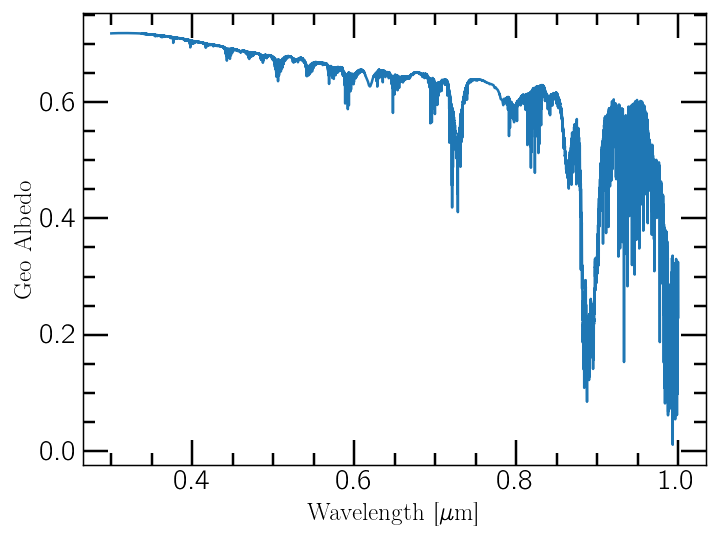

In [42]:
%matplotlib notebook

plt.figure(figsize=(8,6))
plt.minorticks_on()
plt.tick_params(axis='both',which='major',length =20, width=2,direction='in',labelsize=23)
plt.tick_params(axis='both',which='minor',length =10, width=2,direction='in',labelsize=23)

plt.plot(1e4/cannedCJwno, cannedCJalb, lw=2)

#plt.xlim(0.3,2.0)
#plt.ylim(bottom = 1e-11)
#plt.gca().set_yscale('log')
plt.gca().set_xlabel(r'Wavelength [$\mu$m]')
plt.gca().set_ylabel('Geo Albedo')
plt.tight_layout()

# Using My Function

In [44]:
from myastrotools.tools import MakeModelPlanet

## Planet:
planettype = 'ColdJup'
tint = 100 # Internal Temperature of your Planet in K
Teq = 200 # planet equilibrium temperature 
radius = 1 #Rjup
msinij = 1
semi_major = 0.73

## Star:
T_star = 6000.0 # K, star effective temperature
logg = 4.437 #logg , cgs
metal = 0.0122 # metallicity of star
r_star = 0.8 # solar radius


## Climate:
nlevel = 91 # number of plane-parallel levels in your code
nofczns = 1 # number of convective zones initially. Let's not play with this for now.
nstr_upper = 85 # top most level of guessed convective zone
nstr_deep = nlevel -2 # this is always the case. Dont change this
nstr = np.array([0,nstr_upper,nstr_deep,0,0,0]) # initial guess of convective zones
rfacv = 0.5

## Opacities:
#planet_mh_str = '+200'#'+2' #log metallicity
planet_mh_str = '+050'#'+2' #log metallicity
planet_mh = float(planet_mh_str[1:])/100
planet_mh_CtoO_str = '100'#'0.5' # CtoO ratio
ck_db = f'/Volumes/Oy/picaso/reference/kcoeff_2020/sonora_2020_feh{planet_mh_str}_co_{planet_mh_CtoO_str}.data.196'
opacity_ck = jdi.opannection(ck_db=ck_db)

# cloud properties:
mean_molecular_weight = 2.2
fsed = 1
kz = 1e9

# save model params
filename = f'{planettype}-Teq{Teq}-sep{semi_major}-mh{planet_mh_str}-co{planet_mh_CtoO_str}-fsed{fsed}-Tstar{T_star}-mmw{mean_molecular_weight}.nc'
savefilename = '/Volumes/Oy/Reflected-Light-Ames/models/'+filename

    
    
planet_properties = {
    'tint':tint, 'Teq':Teq, 'radius':radius, 'radius_unit':u.Rjup,
     'mass':msinij, 'mass_unit': u.Mjup,
     'gravity': None, 'gravity_unit':None,
    'semi_major':semi_major, 'semi_major_unit': u.AU,
    'mh': planet_mh, 'CtoO':planet_mh_CtoO_str
}

star_properties = {
    'Teff':T_star, 'logg':logg, 'mh':metal, 'radius':r_star
}

climate_run_setup = {
    'nlevel':nlevel, 'nofczns':nofczns, 'nstr_upper':nstr_upper,
    'nstr_deep':nstr_deep, 'rfacv':rfacv
}

cloud_properties = {
    'fsed':fsed, 'mean_mol_weight': mean_molecular_weight, 'kz':kz
}


cj = MakeModelPlanet(planet_properties, 
                        star_properties, 
                        opacity_ck,
                        use_guillotpt = True,
                        compute_climate = True,
                        cdict = climate_run_setup,
                        climate_pbottom = 2,
                        climate_ptop = -6, 
                        clouddict = cloud_properties, 
                        spectrum_wavelength_range = [0.3,2.2],
                        spectrum_calculation = 'reflected',
                        spectrum_resolution = 150,
                        savemodel = True,
                        savefilename = savefilename
             )


starting climate run
Iteration number  0 , min , max temp  176.70049440930404 655.0990332644511 , flux balance  -24.31895028959684
Iteration number  1 , min , max temp  188.41361734137462 935.5056528943012 , flux balance  -20.972264523339714
Iteration number  2 , min , max temp  208.02143911256607 1088.9600345537388 , flux balance  -12.952408918646155
Iteration number  3 , min , max temp  227.61882675157503 1279.4703170419539 , flux balance  3.728747526181642
Iteration number  4 , min , max temp  225.65407511734185 1239.2041436021884 , flux balance  0.17633590192518195
Iteration number  5 , min , max temp  225.59104483187818 1235.1310114987923 , flux balance  0.0007235099689919382
In t_start: Converged Solution in iterations  5
Big iteration is  225.59104483187818 0
Iteration number  0 , min , max temp  225.752799401364 1268.7047323221457 , flux balance  -11.56665332044657
Iteration number  1 , min , max temp  226.2043124111099 1370.0700086401916 , flux balance  -8.900845492509367
Iter

Iteration number  0 , min , max temp  224.2482253135723 1392.2762400314452 , flux balance  4.735043060762842e-05
In t_start: Converged Solution in iterations  0
Profile converged
[ 0 66 77 77 85 89]
Iteration number  0 , min , max temp  224.2780156738464 1391.52412521507 , flux balance  0.003363607076980198
In t_start: Converged Solution in iterations  0
Big iteration is  224.2780156738464 0
Iteration number  0 , min , max temp  224.2790894566586 1391.8450345538972 , flux balance  0.0002197387011583126
In t_start: Converged Solution in iterations  0
Profile converged
[ 0 65 77 77 85 89]
Iteration number  0 , min , max temp  224.34705275692048 1392.7515831043195 , flux balance  0.015288971329304752
Iteration number  1 , min , max temp  224.34680560166683 1392.730544336558 , flux balance  2.2073619824413946e-05
In t_start: Converged Solution in iterations  1
Big iteration is  224.34680560166683 0
Iteration number  0 , min , max temp  224.36059276980006 1390.9198230996174 , flux balance  

In [39]:
(c.G*(1*u.Mjup)/((1*u.Rjup)**2)).decompose()

<Quantity 24.78651948 m / s2>

In [48]:
pl, noclouds, w_noclouds, f_noclouds, clouds, clouds_added, mols, clouds_spectrum, w_clouds, f_clouds = cj

df = clouds_spectrum
CJwno, CJalb, CJfull_output = df['wavenumber'] , df['albedo'] , df['full_output'] 

<IPython.core.display.Javascript object>


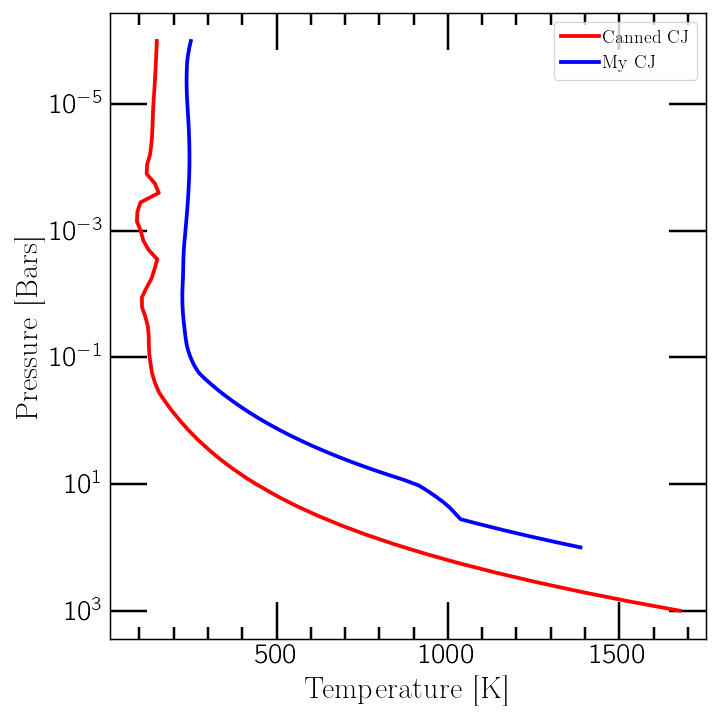

In [59]:
#### Plot PT profile:
plt.figure(figsize=(8,8))
plt.ylabel("Pressure [Bars]", fontsize=25)
plt.xlabel('Temperature [K]', fontsize=25)
plt.gca().invert_yaxis()
#plt.ylim(500,1e-4)
#plt.xlim(200,3000)
#plt.ylim(bottom=1e2)

plt.semilogy(cannedCJfull_output['level']['temperature'],
             cannedCJfull_output['level']['pressure'],color="r",linewidth=3,label="Canned CJ")

plt.semilogy(CJfull_output['level']['temperature'],
             CJfull_output['level']['pressure'],color="blue",linewidth=3,label="My CJ")

plt.minorticks_on() 
plt.tick_params(axis='both',which='major',length =30, width=2,direction='in',labelsize=23)
plt.tick_params(axis='both',which='minor',length =10, width=2,direction='in',labelsize=23)

plt.legend(fontsize=15)

#plt.title(r"T$_{\rm eff}$= "+str(Teq)+" K, log(g)= "+\
##          str(np.round(cl_wj.inputs['planet']['gravity']/100, decimals=2))\
 #         +r" m s$^{-2}$",fontsize=25)

plt.tight_layout()

<IPython.core.display.Javascript object>


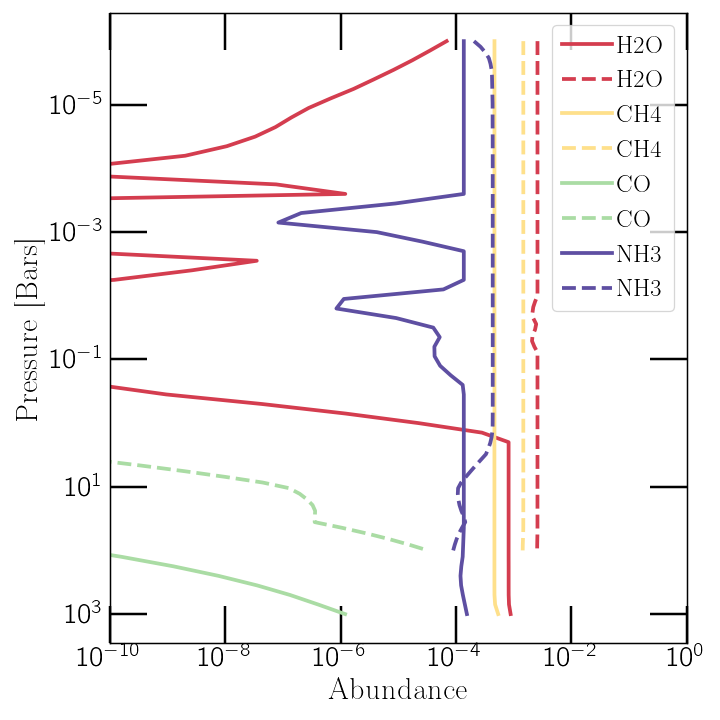

In [54]:
#mols = ['H2O','CH4','CO','NH3']
mols = ['H2O','CH4','CO','NH3']

#### Use 'ptchem_df' output from climate model, which contains the chemical structure of the
# computed climate.

%matplotlib notebook

import matplotlib

cmap = matplotlib.cm.get_cmap('Spectral')

n = len(mols)
cs = np.linspace(0.1,1,n)
colors = cmap(cs)

#colors = 

plt.figure(figsize=(8,8))
plt.minorticks_on()
plt.tick_params(axis='both',which='major',length =30, width=2,direction='in',labelsize=23)
plt.tick_params(axis='both',which='minor',length =10, width=2,direction='in',labelsize=23)

plt.ylabel("Pressure [Bars]", fontsize=25)
plt.xlabel('Abundance', fontsize=25)
plt.gca().invert_yaxis()
#plt.ylim(500,1e-4)
plt.xlim(left=1e-10)

for i,mol in enumerate(mols):
    plt.plot(cannedCJ.inputs['atmosphere']['profile'][mol],
             cannedCJ.inputs['atmosphere']['profile']['pressure'],
             color=colors[i],linewidth=3,label=mol)
    
    plt.plot(clouds.inputs['atmosphere']['profile'][mol],
             clouds.inputs['atmosphere']['profile']['pressure'],
             color=colors[i],linewidth=3,label=mol, ls='--')
plt.gca().set_yscale('log')
plt.gca().set_xscale('log')
#plt.gca().invert_yaxis()
plt.legend(fontsize=20)
plt.tight_layout()

In [55]:
jpi.show(jpi.mixing_ratio(CJfull_output))

# Very different.  I wonder if it's from the cloud chemistry differences

In [56]:
from virga import justdoit as vj 

# pressure temp profile from climate run:
temperature = cannedCJ.inputs['atmosphere']['profile']['temperature']
pressure = cannedCJ.inputs['atmosphere']['profile']['pressure']
metallicity = 1 #atmospheric metallicity relative to Solar
mean_molecular_weight = 2.2 # atmospheric mean molecular weight

#get virga recommendation for which gases to run
recommended = vj.recommend_gas(pressure, temperature, metallicity, mean_molecular_weight,
                #Turn on plotting
                 plot=True)
#print the results
print(recommended)

['H2O', 'KCl', 'MnS', 'NH3', 'Na2S', 'ZnS']


In [57]:
from virga import justdoit as vj 

# pressure temp profile from climate run:
temperature = clouds.inputs['atmosphere']['profile']['temperature']
pressure = clouds.inputs['atmosphere']['profile']['pressure']
metallicity = 1 #atmospheric metallicity relative to Solar
mean_molecular_weight = 2.2 # atmospheric mean molecular weight

#get virga recommendation for which gases to run
recommended = vj.recommend_gas(pressure, temperature, metallicity, mean_molecular_weight,
                #Turn on plotting
                 plot=True)
#print the results
print(recommended)

['KCl', 'Na2S', 'ZnS']


# The PT profile is the problem.  What can I change to get a similar PT prof?

## try changing Teq?

In [61]:
from myastrotools.tools import MakeModelPlanet

## Planet:
planettype = 'ColdJup'
tint = 100 # Internal Temperature of your Planet in K
Teq = 200 # planet equilibrium temperature 
radius = 1 #Rjup
msinij = 1
semi_major = 0.73

## Star:
T_star = 6000.0 # K, star effective temperature
logg = 4.437 #logg , cgs
metal = 0.0122 # metallicity of star
r_star = 0.8 # solar radius


## Climate:
nlevel = 91 # number of plane-parallel levels in your code
nofczns = 1 # number of convective zones initially. Let's not play with this for now.
nstr_upper = 85 # top most level of guessed convective zone
nstr_deep = nlevel -2 # this is always the case. Dont change this
nstr = np.array([0,nstr_upper,nstr_deep,0,0,0]) # initial guess of convective zones
rfacv = 0.5

Teq_models = [cj]
Teqs = np.array([150,250,300])

for Teq in Teqs:
    print(Teq)
    ## Opacities:
    #planet_mh_str = '+200'#'+2' #log metallicity
    planet_mh_str = '+050'#'+2' #log metallicity
    planet_mh = float(planet_mh_str[1:])/100
    planet_mh_CtoO_str = '100'#'0.5' # CtoO ratio
    ck_db = f'/Volumes/Oy/picaso/reference/kcoeff_2020/sonora_2020_feh{planet_mh_str}_co_{planet_mh_CtoO_str}.data.196'
    opacity_ck = jdi.opannection(ck_db=ck_db)

    # cloud properties:
    mean_molecular_weight = 2.2
    fsed = 1
    kz = 1e9

    # save model params
    filename = f'{planettype}-Teq{Teq}-sep{semi_major}-mh{planet_mh_str}-co{planet_mh_CtoO_str}-fsed{fsed}-Tstar{T_star}-mmw{mean_molecular_weight}.nc'
    savefilename = '/Volumes/Oy/Reflected-Light-Ames/models/'+filename



    planet_properties = {
        'tint':tint, 'Teq':Teq, 'radius':radius, 'radius_unit':u.Rjup,
         'mass':msinij, 'mass_unit': u.Mjup,
         'gravity': None, 'gravity_unit':None,
        'semi_major':semi_major, 'semi_major_unit': u.AU,
        'mh': planet_mh, 'CtoO':planet_mh_CtoO_str
    }

    star_properties = {
        'Teff':T_star, 'logg':logg, 'mh':metal, 'radius':r_star
    }

    climate_run_setup = {
        'nlevel':nlevel, 'nofczns':nofczns, 'nstr_upper':nstr_upper,
        'nstr_deep':nstr_deep, 'rfacv':rfacv
    }

    cloud_properties = {
        'fsed':fsed, 'mean_mol_weight': mean_molecular_weight, 'kz':kz
    }


    cj_temp = MakeModelPlanet(planet_properties, 
                            star_properties, 
                            opacity_ck,
                            use_guillotpt = True,
                            compute_climate = True,
                            cdict = climate_run_setup,
                            climate_pbottom = 2,
                            climate_ptop = -6, 
                            clouddict = cloud_properties, 
                            spectrum_wavelength_range = [0.3,2.2],
                            spectrum_calculation = 'reflected',
                            spectrum_resolution = 150,
                            savemodel = True,
                            savefilename = savefilename
                 )
    Teq_models.append(cj_temp)
    


150
starting climate run
Iteration number  0 , min , max temp  138.33709108505172 615.0261830179782 , flux balance  -38.297390227327796
Iteration number  1 , min , max temp  174.2610038099517 929.5211775107892 , flux balance  -29.606196916265365
Iteration number  2 , min , max temp  211.0615330584241 1104.8867590220498 , flux balance  -11.953513251706642
Iteration number  3 , min , max temp  228.34925617620664 1199.5853772449311 , flux balance  1.5085263112352763
Iteration number  4 , min , max temp  226.45361577266587 1187.5094804649073 , flux balance  0.01855249894854215
Iteration number  5 , min , max temp  226.4266193817168 1187.219812524354 , flux balance  1.1203760013819029e-05
In t_start: Converged Solution in iterations  5
Big iteration is  226.4266193817168 0
Iteration number  0 , min , max temp  227.03016806306752 1223.5722733982043 , flux balance  -18.864630510737836
Iteration number  1 , min , max temp  228.75869932590254 1339.3018132029893 , flux balance  -14.8522060859336

Iteration number  0 , min , max temp  224.251319894198 1391.2482550424797 , flux balance  0.0018715399558106962
In t_start: Converged Solution in iterations  0
Big iteration is  224.251319894198 0
Iteration number  0 , min , max temp  224.24822333285894 1392.2762400256468 , flux balance  4.7351991680269594e-05
In t_start: Converged Solution in iterations  0
Profile converged
[ 0 66 77 77 85 89]
Iteration number  0 , min , max temp  224.2780237044125 1391.524126405967 , flux balance  0.0033636187576652397
In t_start: Converged Solution in iterations  0
Big iteration is  224.2780237044125 0
Iteration number  0 , min , max temp  224.27907920395714 1391.845033873326 , flux balance  0.00021972660943499656
In t_start: Converged Solution in iterations  0
Profile converged
[ 0 65 77 77 85 89]
Iteration number  0 , min , max temp  224.34705762355094 1392.7515832621436 , flux balance  0.015289000806899714
Iteration number  1 , min , max temp  224.34681045673105 1392.7305444899082 , flux balance 

Iteration number  0 , min , max temp  224.36446667162528 1401.9678984694226 , flux balance  0.001856555911362077
In t_start: Converged Solution in iterations  0
Profile converged
 convection zone status
0 85 89 0 0 0
1
[ 0 74 74 74 85 89]
Iteration number  0 , min , max temp  224.3675722916024 1402.2053858811616 , flux balance  0.0002466730178687253
In t_start: Converged Solution in iterations  0
Big iteration is  224.3675722916024 0
Iteration number  0 , min , max temp  224.3721364940165 1401.7084544945515 , flux balance  5.726740627284197e-05
In t_start: Converged Solution in iterations  0
Profile converged
Grow Phase : Upper Zone
[ 0 73 74 74 85 89]
Iteration number  0 , min , max temp  224.353557135554 1400.8646352445307 , flux balance  0.00045806973870823664
Iteration number  1 , min , max temp  224.35353450394467 1400.8673257505186 , flux balance  2.8715589972096505e-07
In t_start: Converged Solution in iterations  1
Big iteration is  224.35353450394467 0
Iteration number  0 , mi

Iteration number  0 , min , max temp  225.07469291042872 1396.5923893063634 , flux balance  0.06038835850560879
Iteration number  1 , min , max temp  225.07236671188133 1396.4818434781407 , flux balance  0.0004730068726308298
In t_start: Converged Solution in iterations  1
Big iteration is  225.07236671188133 0
Iteration number  0 , min , max temp  225.1903669187103 1387.1235159247053 , flux balance  0.00816671188323431
Iteration number  1 , min , max temp  225.19049468973353 1386.8579445053415 , flux balance  4.972045910274931e-05
In t_start: Converged Solution in iterations  1
Profile converged
[ 0 61 78 78 85 89]
Iteration number  0 , min , max temp  225.14551884516808 1384.1285327778278 , flux balance  -0.00048502370880448793
In t_start: Converged Solution in iterations  0
Big iteration is  225.14551884516808 0
Iteration number  0 , min , max temp  225.1416858968001 1386.9777698005857 , flux balance  0.00010189009380740689
In t_start: Converged Solution in iterations  0
Profile con

Iteration number  0 , min , max temp  224.24791137514413 1394.8733912480357 , flux balance  0.000708046596957298
Iteration number  1 , min , max temp  224.24787812783927 1394.8739124451859 , flux balance  1.900555056607214e-07
In t_start: Converged Solution in iterations  1
Big iteration is  224.24787812783927 0
Iteration number  0 , min , max temp  224.24980161650106 1395.4048600082267 , flux balance  0.00019513357349235463
In t_start: Converged Solution in iterations  0
Profile converged
[ 0 69 76 76 85 89]
Iteration number  0 , min , max temp  224.2324470471777 1396.745746762822 , flux balance  0.0009925060467517862
Iteration number  1 , min , max temp  224.23240464900945 1396.7564197257136 , flux balance  1.6141894159614222e-06
In t_start: Converged Solution in iterations  1
Big iteration is  224.23240464900945 0
Iteration number  0 , min , max temp  224.25207626526807 1393.9400163239886 , flux balance  9.909144184907963e-05
In t_start: Converged Solution in iterations  0
Profile c

In [65]:
len(Teq_models)

4

<IPython.core.display.Javascript object>


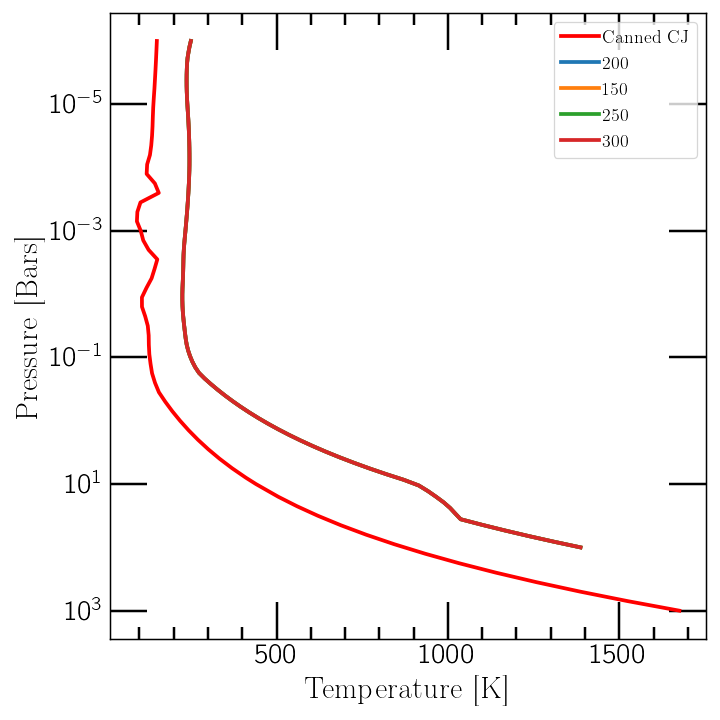

In [74]:
#### Plot PT profile:
plt.figure(figsize=(8,8))
plt.ylabel("Pressure [Bars]", fontsize=25)
plt.xlabel('Temperature [K]', fontsize=25)
plt.gca().invert_yaxis()
#plt.ylim(500,1e-4)
#plt.xlim(200,3000)
#plt.ylim(bottom=1e2)

plt.semilogy(cannedCJfull_output['level']['temperature'],
             cannedCJfull_output['level']['pressure'],color="r",linewidth=3,label="Canned CJ")

Teqs = np.array([200,150,250,300])
for i in range(len(Teq_models)):
    pl, noclouds, w_noclouds, f_noclouds, clouds, clouds_added, mols, clouds_spectrum, w_clouds, f_clouds = Teq_models[i]

    df = clouds_spectrum
    CJwno, CJalb, CJfull_output = df['wavenumber'] , df['albedo'] , df['full_output'] 

    plt.semilogy(CJfull_output['level']['temperature'],
             CJfull_output['level']['pressure'],linewidth=3,label=Teqs[i])

plt.minorticks_on() 
plt.tick_params(axis='both',which='major',length =30, width=2,direction='in',labelsize=23)
plt.tick_params(axis='both',which='minor',length =10, width=2,direction='in',labelsize=23)

plt.legend(fontsize=15)

#plt.title(r"T$_{\rm eff}$= "+str(Teq)+" K, log(g)= "+\
##          str(np.round(cl_wj.inputs['planet']['gravity']/100, decimals=2))\
 #         +r" m s$^{-2}$",fontsize=25)

plt.tight_layout()

## How about Tint?

In [15]:
from myastrotools.tools import MakeModelPlanet

## Planet:
planettype = 'ColdJup'
#tint = 100 # Internal Temperature of your Planet in K
Teq = 200 # planet equilibrium temperature 
radius = 1 #Rjup
msinij = 1
semi_major = 0.73

## Star:
T_star = 6000.0 # K, star effective temperature
logg = 4.437 #logg , cgs
metal = 0.0122 # metallicity of star
r_star = 0.8 # solar radius


## Climate:
nlevel = 91 # number of plane-parallel levels in your code
nofczns = 1 # number of convective zones initially. Let's not play with this for now.
nstr_upper = 85 # top most level of guessed convective zone
nstr_deep = nlevel -2 # this is always the case. Dont change this
nstr = np.array([0,nstr_upper,nstr_deep,0,0,0]) # initial guess of convective zones
rfacv = 0.5

Tint_models = []
Tints = np.array([100,150,250])

for Tint in Tints:
    print(Tint)
    ## Opacities:
    #planet_mh_str = '+200'#'+2' #log metallicity
    planet_mh_str = '+050'#'+2' #log metallicity
    planet_mh = float(planet_mh_str[1:])/100
    planet_mh_CtoO_str = '100'#'0.5' # CtoO ratio
    ck_db = f'/Volumes/Oy/picaso/reference/kcoeff_2020/sonora_2020_feh{planet_mh_str}_co_{planet_mh_CtoO_str}.data.196'
    opacity_ck = jdi.opannection(ck_db=ck_db)

    # cloud properties:
    mean_molecular_weight = 2.2
    fsed = 1
    kz = 1e9

    # save model params
    filename = f'{planettype}-Teq{Teq}-sep{semi_major}-mh{planet_mh_str}-co{planet_mh_CtoO_str}-fsed{fsed}-Tstar{T_star}-mmw{mean_molecular_weight}.nc'
    savefilename = '/Volumes/Oy/Reflected-Light-Ames/models/'+filename



    planet_properties = {
        'tint':Tint, 'Teq':Teq, 'radius':radius, 'radius_unit':u.Rjup,
         'mass':msinij, 'mass_unit': u.Mjup,
         'gravity': None, 'gravity_unit':None,
        'semi_major':semi_major, 'semi_major_unit': u.AU,
        'mh': planet_mh, 'CtoO':planet_mh_CtoO_str
    }

    star_properties = {
        'Teff':T_star, 'logg':logg, 'mh':metal, 'radius':r_star
    }

    climate_run_setup = {
        'nlevel':nlevel, 'nofczns':nofczns, 'nstr_upper':nstr_upper,
        'nstr_deep':nstr_deep, 'rfacv':rfacv
    }

    cloud_properties = {
        'fsed':fsed, 'mean_mol_weight': mean_molecular_weight, 'kz':kz
    }


    cj_temp = MakeModelPlanet(planet_properties, 
                            star_properties, 
                            opacity_ck,
                            use_guillotpt = True,
                            compute_climate = True,
                            cdict = climate_run_setup,
                            climate_pbottom = 2,
                            climate_ptop = -6, 
                            clouddict = cloud_properties, 
                            spectrum_wavelength_range = [0.3,2.2],
                            spectrum_calculation = 'reflected',
                            spectrum_resolution = 150,
                            savemodel = True,
                            savefilename = savefilename
                 )
    Tint_models.append(cj_temp)
    


100
starting climate run
Iteration number  0 , min , max temp  176.70049440930404 655.0990332644511 , flux balance  -24.31895028959684
Iteration number  1 , min , max temp  188.41361734137462 935.5056528943012 , flux balance  -20.972264523339714
Iteration number  2 , min , max temp  208.02143911256607 1088.9600345537388 , flux balance  -12.952408918646155
Iteration number  3 , min , max temp  227.61882675157503 1279.4703170419539 , flux balance  3.728747526181642
Iteration number  4 , min , max temp  225.65407511734185 1239.2041436021884 , flux balance  0.17633590192518195
Iteration number  5 , min , max temp  225.59104483187818 1235.1310114987923 , flux balance  0.0007235099689919382
In t_start: Converged Solution in iterations  5
Big iteration is  225.59104483187818 0
Iteration number  0 , min , max temp  225.752799401364 1268.7047323221457 , flux balance  -11.56665332044657
Iteration number  1 , min , max temp  226.2043124111099 1370.0700086401916 , flux balance  -8.900845492509367


Iteration number  0 , min , max temp  224.2482253135723 1392.2762400314452 , flux balance  4.735043060762842e-05
In t_start: Converged Solution in iterations  0
Profile converged
[ 0 66 77 77 85 89]
Iteration number  0 , min , max temp  224.2780156738464 1391.52412521507 , flux balance  0.003363607076980198
In t_start: Converged Solution in iterations  0
Big iteration is  224.2780156738464 0
Iteration number  0 , min , max temp  224.2790894566586 1391.8450345538972 , flux balance  0.0002197387011583126
In t_start: Converged Solution in iterations  0
Profile converged
[ 0 65 77 77 85 89]
Iteration number  0 , min , max temp  224.34705275692048 1392.7515831043195 , flux balance  0.015288971329304752
Iteration number  1 , min , max temp  224.34680560166683 1392.730544336558 , flux balance  2.2073619824413946e-05
In t_start: Converged Solution in iterations  1
Big iteration is  224.34680560166683 0
Iteration number  0 , min , max temp  224.36059276980006 1390.9198230996174 , flux balance  

Iteration number  0 , min , max temp  224.89208352129037 1567.3637038788308 , flux balance  0.00020752285220348318
Iteration number  1 , min , max temp  224.89204930784888 1567.3667329383538 , flux balance  2.2668047914645616e-07
In t_start: Converged Solution in iterations  1
Big iteration is  224.89204930784888 0
Iteration number  0 , min , max temp  224.90442773288086 1567.038227430677 , flux balance  3.79684938830371e-05
In t_start: Converged Solution in iterations  0
Profile converged
Grow Phase : Upper Zone
[ 0 72 73 73 85 89]
Iteration number  0 , min , max temp  224.8826374926436 1566.2389920856237 , flux balance  0.0003292714462512106
Iteration number  1 , min , max temp  224.88256548507817 1566.2466713167455 , flux balance  6.690110583966509e-07
In t_start: Converged Solution in iterations  1
Big iteration is  224.88256548507817 0
Iteration number  0 , min , max temp  224.88553994344178 1566.2357245012975 , flux balance  6.387042340050757e-06
In t_start: Converged Solution in

Iteration number  0 , min , max temp  225.72406934148736 1553.3480175880131 , flux balance  0.02161092326473501
Iteration number  1 , min , max temp  225.7199556533267 1553.4071757791764 , flux balance  0.0001549955374892133
In t_start: Converged Solution in iterations  1
Big iteration is  225.7199556533267 0
Iteration number  0 , min , max temp  225.8244625788773 1550.6012873734096 , flux balance  0.002669912982181209
Iteration number  1 , min , max temp  225.82436575033066 1550.5696857359483 , flux balance  1.3160872141442047e-05
In t_start: Converged Solution in iterations  1
Profile converged
[ 0 60 77 77 85 89]
Iteration number  0 , min , max temp  225.86996811564984 1552.6258075651444 , flux balance  0.007307972092517964
Iteration number  1 , min , max temp  225.86932785506454 1552.6579571479308 , flux balance  6.164773867434737e-05
In t_start: Converged Solution in iterations  1
Big iteration is  225.86932785506454 0
Iteration number  0 , min , max temp  225.96106066081515 1550.

Iteration number  0 , min , max temp  228.55551798076195 2011.5547696350882 , flux balance  8.501303447201978e-05
Iteration number  1 , min , max temp  228.5554275536582 2011.553138736864 , flux balance  1.1122249163959165e-07
In t_start: Converged Solution in iterations  1
Big iteration is  228.5554275536582 0
Iteration number  0 , min , max temp  228.5560501444682 2011.491812723117 , flux balance  2.211554036629249e-07
In t_start: Converged Solution in iterations  0
Profile converged
[ 0 67 74 74 85 89]
Iteration number  0 , min , max temp  228.58027731434169 2010.9103851840966 , flux balance  0.00048564111030393876
Iteration number  1 , min , max temp  228.57996357730673 2010.9138166310177 , flux balance  1.7340787216811484e-06
In t_start: Converged Solution in iterations  1
Big iteration is  228.57996357730673 0
Iteration number  0 , min , max temp  228.5964866487896 2010.8934306823173 , flux balance  9.297373490424656e-06
In t_start: Converged Solution in iterations  0
Profile con

Iteration number  0 , min , max temp  231.35313904081244 1995.6648981890983 , flux balance  -1.1310008395180185e-06
In t_start: Converged Solution in iterations  0
Big iteration is  231.35313904081244 0
Iteration number  0 , min , max temp  231.35319149832196 1995.7396816122382 , flux balance  -3.954453465546875e-07
In t_start: Converged Solution in iterations  0
Profile converged
[ 0 57 80 80 85 89]
Iteration number  0 , min , max temp  231.36040837429982 1995.2039087290536 , flux balance  -0.0001304581224372127
In t_start: Converged Solution in iterations  0
Big iteration is  231.36040837429982 0
Iteration number  0 , min , max temp  231.37528846089631 1995.4861812633053 , flux balance  -6.451464810743955e-05
In t_start: Converged Solution in iterations  0
Profile converged
final [ 0 57 80 80 85 89]
Iteration number  0 , min , max temp  231.37779479074746 1995.575737314629 , flux balance  -2.5878567070424497e-05
In t_start: Converged Solution in iterations  0
Big iteration is  231.37

In [16]:
len(Tint_models)

3

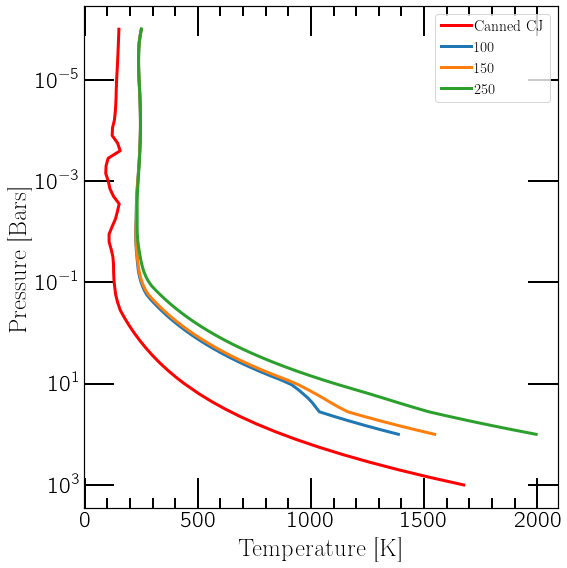

In [17]:
#### Plot PT profile:
plt.figure(figsize=(8,8))
plt.ylabel("Pressure [Bars]", fontsize=25)
plt.xlabel('Temperature [K]', fontsize=25)
plt.gca().invert_yaxis()
#plt.ylim(500,1e-4)
#plt.xlim(200,3000)
#plt.ylim(bottom=1e2)

plt.semilogy(cannedCJfull_output['level']['temperature'],
             cannedCJfull_output['level']['pressure'],color="r",linewidth=3,label="Canned CJ")

Tints = np.array([100,150,250])
for i in range(len(Tint_models)):
    pl, noclouds, w_noclouds, f_noclouds, clouds, clouds_added, mols, clouds_spectrum, w_clouds, f_clouds = Tint_models[i]

    df = clouds_spectrum
    CJwno, CJalb, CJfull_output = df['wavenumber'] , df['albedo'] , df['full_output'] 

    plt.semilogy(CJfull_output['level']['temperature'],
             CJfull_output['level']['pressure'],linewidth=3,label=Tints[i])

plt.minorticks_on() 
plt.tick_params(axis='both',which='major',length =30, width=2,direction='in',labelsize=23)
plt.tick_params(axis='both',which='minor',length =10, width=2,direction='in',labelsize=23)

plt.legend(fontsize=15)

#plt.title(r"T$_{\rm eff}$= "+str(Teq)+" K, log(g)= "+\
##          str(np.round(cl_wj.inputs['planet']['gravity']/100, decimals=2))\
 #         +r" m s$^{-2}$",fontsize=25)

plt.tight_layout()

## Separation?

In [69]:
from myastrotools.tools import MakeModelPlanet

## Planet:
planettype = 'ColdJup'
tint = 100 # Internal Temperature of your Planet in K
Teq = 200 # planet equilibrium temperature 
radius = 1 #Rjup
msinij = 1
#semi_major = 0.73


## Star:
T_star = 6000.0 # K, star effective temperature
logg = 4.437 #logg , cgs
metal = 0.0122 # metallicity of star
r_star = 0.8 # solar radius


## Climate:
nlevel = 91 # number of plane-parallel levels in your code
nofczns = 1 # number of convective zones initially. Let's not play with this for now.
nstr_upper = 85 # top most level of guessed convective zone
nstr_deep = nlevel -2 # this is always the case. Dont change this
nstr = np.array([0,nstr_upper,nstr_deep,0,0,0]) # initial guess of convective zones
rfacv = 0.5

Sep_models = []
semi_majors = np.array([0.5,3,5])

for semi_major in semi_majors:
    print(semi_major)
    ## Opacities:
    #planet_mh_str = '+200'#'+2' #log metallicity
    planet_mh_str = '+050'#'+2' #log metallicity
    planet_mh = float(planet_mh_str[1:])/100
    planet_mh_CtoO_str = '100'#'0.5' # CtoO ratio
    ck_db = f'/Volumes/Oy/picaso/reference/kcoeff_2020/sonora_2020_feh{planet_mh_str}_co_{planet_mh_CtoO_str}.data.196'
    opacity_ck = jdi.opannection(ck_db=ck_db)

    # cloud properties:
    mean_molecular_weight = 2.2
    fsed = 1
    kz = 1e9

    # save model params
    filename = f'{planettype}-Teq{Teq}-sep{semi_major}-mh{planet_mh_str}-co{planet_mh_CtoO_str}-fsed{fsed}-Tstar{T_star}-mmw{mean_molecular_weight}.nc'
    savefilename = '/Volumes/Oy/Reflected-Light-Ames/models/'+filename



    planet_properties = {
        'tint':tint, 'Teq':Teq, 'radius':radius, 'radius_unit':u.Rjup,
         'mass':msinij, 'mass_unit': u.Mjup,
         'gravity': None, 'gravity_unit':None,
        'semi_major':semi_major, 'semi_major_unit': u.AU,
        'mh': planet_mh, 'CtoO':planet_mh_CtoO_str
    }

    star_properties = {
        'Teff':T_star, 'logg':logg, 'mh':metal, 'radius':r_star
    }

    climate_run_setup = {
        'nlevel':nlevel, 'nofczns':nofczns, 'nstr_upper':nstr_upper,
        'nstr_deep':nstr_deep, 'rfacv':rfacv
    }

    cloud_properties = {
        'fsed':fsed, 'mean_mol_weight': mean_molecular_weight, 'kz':kz
    }


    cj_temp = MakeModelPlanet(planet_properties, 
                            star_properties, 
                            opacity_ck,
                            use_guillotpt = True,
                            compute_climate = True,
                            cdict = climate_run_setup,
                            climate_pbottom = 2,
                            climate_ptop = -6, 
                            clouddict = cloud_properties, 
                            spectrum_wavelength_range = [0.3,2.2],
                            spectrum_calculation = 'reflected',
                            spectrum_resolution = 150,
                            savemodel = True,
                            savefilename = savefilename
                 )
    Sep_models.append(cj_temp)
    


0.5
starting climate run
Iteration number  0 , min , max temp  177.02202865944156 653.7472715170649 , flux balance  -81.59012716253132
Iteration number  1 , min , max temp  204.75657493141546 1211.9845608563264 , flux balance  -67.35144172840059
Iteration number  2 , min , max temp  249.1178248804124 1326.51708196267 , flux balance  -29.368082870671667
Iteration number  3 , min , max temp  270.5335119485314 1408.6627266458581 , flux balance  4.372371349473456
Iteration number  4 , min , max temp  268.0247966421106 1396.3852047065984 , flux balance  0.07041564053269367
Iteration number  5 , min , max temp  267.98320028297337 1395.897129580629 , flux balance  0.0001381650413039449
In t_start: Converged Solution in iterations  5
Big iteration is  267.98320028297337 0
Iteration number  0 , min , max temp  268.1517578283454 1412.3259325911563 , flux balance  -40.203025565070085
Iteration number  1 , min , max temp  268.4194784381014 1446.757543947248 , flux balance  -35.98412920728718
Itera

Iteration number  0 , min , max temp  267.09390950063323 1464.522652287103 , flux balance  0.001502769374370419
In t_start: Converged Solution in iterations  0
Profile converged
[ 0 62 73 73 85 89]
Iteration number  0 , min , max temp  267.2060960644393 1467.2487649733287 , flux balance  0.06250287421053162
Iteration number  1 , min , max temp  267.205709621012 1467.2414344767121 , flux balance  0.00013566046157061461
In t_start: Converged Solution in iterations  1
Big iteration is  267.205709621012 0
Iteration number  0 , min , max temp  267.254304401254 1463.798395159048 , flux balance  0.00819177046531604
In t_start: Converged Solution in iterations  0
Profile converged
[ 0 61 73 73 85 89]
Iteration number  0 , min , max temp  267.40199770790593 1468.138102825281 , flux balance  0.12514408120384832
Iteration number  1 , min , max temp  267.4006396813605 1468.1368872082917 , flux balance  0.0003868985438183562
In t_start: Converged Solution in iterations  1
Big iteration is  267.4006

Iteration number  0 , min , max temp  119.66060088825792 1125.183023005282 , flux balance  0.006254233205257086
Iteration number  1 , min , max temp  119.65309971003123 1125.1828023963255 , flux balance  0.00013848385920557012
Iteration number  2 , min , max temp  119.65302684497159 1125.1828023489327 , flux balance  4.722041525953328e-07
In t_start: Converged Solution in iterations  2
Big iteration is  119.65302684497159 0
Iteration number  0 , min , max temp  119.75277354319974 1125.1035649883156 , flux balance  0.005043783355558082
Iteration number  1 , min , max temp  119.75256078468239 1125.1035521158988 , flux balance  8.068563271956572e-05
Iteration number  2 , min , max temp  119.75261032613749 1125.1035521167491 , flux balance  5.74611858409103e-08
In t_start: Converged Solution in iterations  2
Profile converged
Iteration number  0 , min , max temp  119.69273943784191 1114.4168361017105 , flux balance  0.00305750216656281
Iteration number  1 , min , max temp  119.694757854271

Iteration number  0 , min , max temp  119.36257553864183 965.880361287286 , flux balance  0.0028401844783440483
Iteration number  1 , min , max temp  119.36374316805961 965.8803594986674 , flux balance  9.0926550846792e-05
Iteration number  2 , min , max temp  119.36370882569116 965.8803588510797 , flux balance  2.439638979831323e-07
In t_start: Converged Solution in iterations  2
Profile converged
Iteration number  0 , min , max temp  119.47964288128824 959.5134145296184 , flux balance  0.003931324621141015
Iteration number  1 , min , max temp  119.48094430030687 959.5056689319837 , flux balance  5.95762709866259e-05
Iteration number  2 , min , max temp  119.48098261350543 959.5056655742496 , flux balance  3.2080641575838226e-08
In t_start: Converged Solution in iterations  2
Big iteration is  119.48098261350543 0
Iteration number  0 , min , max temp  119.48709315254268 959.7951605267554 , flux balance  0.003032475904463983
Iteration number  1 , min , max temp  119.48942760988675 959.

adding clouds
virga recommended gas species: ['H2O', 'NH3']
5.0
starting climate run
Iteration number  0 , min , max temp  171.21888388337405 664.7567730022768 , flux balance  23.163604518031576
Iteration number  1 , min , max temp  126.83798143025263 1029.4256243716993 , flux balance  6.7466845342813775
Iteration number  2 , min , max temp  90.27978864975913 902.569103293816 , flux balance  1.6835392121118757
Iteration number  3 , min , max temp  75.68801529567318 865.0768253278984 , flux balance  0.2876140375507032
Iteration number  4 , min , max temp  73.19952214398504 862.0592827498165 , flux balance  0.01951390319624886
Iteration number  5 , min , max temp  73.10762704018254 862.0399826638495 , flux balance  0.00016448999339159964
Iteration number  6 , min , max temp  73.10728905515289 862.0399786851576 , flux balance  4.122576538754529e-08
In t_start: Converged Solution in iterations  6
9  points went off the opacity grid. Correcting those.
Big iteration is  73.10728905515289 0
I

Iteration number  0 , min , max temp  52.593430127320936 5199.90099719488 , flux balance  2034.4200172520482
In t_start: Converged Solution in iterations  0
6  points went off the opacity grid. Correcting those.
Profile converged
[ 0 69 72 72 76 89]
Iteration number  0 , min , max temp  52.59379623153119 5199.901038954123 , flux balance  2035.0537621916703
In t_start: Converged Solution in iterations  0
6  points went off the opacity grid. Correcting those.
Big iteration is  52.59379623153119 0
Iteration number  0 , min , max temp  52.59419751222791 5199.901082756728 , flux balance  2035.036405703289
In t_start: Converged Solution in iterations  0
6  points went off the opacity grid. Correcting those.
Profile converged
[ 0 68 72 72 76 89]
Iteration number  0 , min , max temp  52.594891956596605 5199.901124248847 , flux balance  2035.7496062760338
In t_start: Converged Solution in iterations  0
6  points went off the opacity grid. Correcting those.
Big iteration is  52.594891956596605 0

Profile converged
[ 0 56 89  0 76 89]
Iteration number  0 , min , max temp  52.6 5199.9025005839985 , flux balance  2037.3418529827275
In t_start: Converged Solution in iterations  0
7  points went off the opacity grid. Correcting those.
Big iteration is  52.6 0
Iteration number  0 , min , max temp  52.6 5199.902544013345 , flux balance  2037.3099740046418
In t_start: Converged Solution in iterations  0
7  points went off the opacity grid. Correcting those.
Profile converged
[ 0 55 89  0 76 89]
Iteration number  0 , min , max temp  52.6 5199.902585766361 , flux balance  2038.1106134113516
In t_start: Converged Solution in iterations  0
7  points went off the opacity grid. Correcting those.
Big iteration is  52.6 0
Iteration number  0 , min , max temp  52.6 5199.902627311097 , flux balance  2038.1730536797168
In t_start: Converged Solution in iterations  0
7  points went off the opacity grid. Correcting those.
Profile converged
[ 0 54 89  0 76 89]
Iteration number  0 , min , max temp  5

Exception: Many points in your profile went off the grid. Try re-starting from a different guess profile. Parametrized profiles can work better sometime as guess profiles.

In [71]:
len(Sep_models)

2

<IPython.core.display.Javascript object>


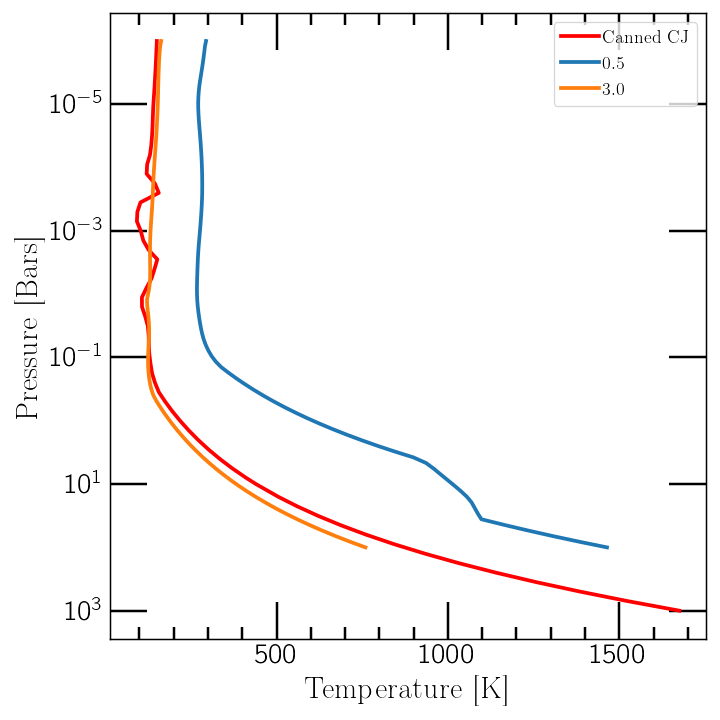

In [76]:
#### Plot PT profile:
plt.figure(figsize=(8,8))
plt.ylabel("Pressure [Bars]", fontsize=25)
plt.xlabel('Temperature [K]', fontsize=25)
plt.gca().invert_yaxis()
#plt.ylim(500,1e-4)
#plt.xlim(200,3000)
#plt.ylim(bottom=1e2)

plt.semilogy(cannedCJfull_output['level']['temperature'],
             cannedCJfull_output['level']['pressure'],color="r",linewidth=3,label="Canned CJ")

semi_majors = np.array([0.5,3,5])
for i in range(2):
    pl, noclouds, w_noclouds, f_noclouds, clouds, clouds_added, mols, clouds_spectrum, w_clouds, f_clouds = Sep_models[i]

    df = clouds_spectrum
    CJwno, CJalb, CJfull_output = df['wavenumber'] , df['albedo'] , df['full_output'] 

    plt.semilogy(CJfull_output['level']['temperature'],
             CJfull_output['level']['pressure'],linewidth=3,label=semi_majors[i])

plt.minorticks_on() 
plt.tick_params(axis='both',which='major',length =30, width=2,direction='in',labelsize=23)
plt.tick_params(axis='both',which='minor',length =10, width=2,direction='in',labelsize=23)

plt.legend(fontsize=15)

#plt.title(r"T$_{\rm eff}$= "+str(Teq)+" K, log(g)= "+\
##          str(np.round(cl_wj.inputs['planet']['gravity']/100, decimals=2))\
 #         +r" m s$^{-2}$",fontsize=25)

plt.tight_layout()

In [78]:
i = 1
pl, noclouds, w_noclouds, f_noclouds, clouds, clouds_added, mols, clouds_spectrum, w_clouds, f_clouds = Sep_models[i]
df = clouds_spectrum
CJwno, CJalb, CJfull_output = df['wavenumber'] , df['albedo'] , df['full_output'] 

In [79]:
from virga import justdoit as vj 

# pressure temp profile from climate run:
temperature = clouds.inputs['atmosphere']['profile']['temperature']
pressure = clouds.inputs['atmosphere']['profile']['pressure']
metallicity = 1 #atmospheric metallicity relative to Solar
mean_molecular_weight = 2.2 # atmospheric mean molecular weight

#get virga recommendation for which gases to run
recommended = vj.recommend_gas(pressure, temperature, metallicity, mean_molecular_weight,
                #Turn on plotting
                 plot=True)
#print the results
print(recommended)

['H2O', 'NH3']


In [77]:
from virga import justdoit as vj 

# pressure temp profile from climate run:
temperature = cannedCJ.inputs['atmosphere']['profile']['temperature']
pressure = cannedCJ.inputs['atmosphere']['profile']['pressure']
metallicity = 1 #atmospheric metallicity relative to Solar
mean_molecular_weight = 2.2 # atmospheric mean molecular weight

#get virga recommendation for which gases to run
recommended = vj.recommend_gas(pressure, temperature, metallicity, mean_molecular_weight,
                #Turn on plotting
                 plot=True)
#print the results
print(recommended)

['H2O', 'KCl', 'MnS', 'NH3', 'Na2S', 'ZnS']


In [81]:
from myastrotools.tools import MakeModelPlanet

## Planet:
planettype = 'ColdJup'
tint = 100 # Internal Temperature of your Planet in K
Teq = 200 # planet equilibrium temperature 
radius = 1 #Rjup
msinij = 1
semi_major = 3


## Star:
T_star = 6000.0 # K, star effective temperature
logg = 4.437 #logg , cgs
metal = 0.0122 # metallicity of star
r_star = 0.8 # solar radius


## Climate:
nlevel = 91 # number of plane-parallel levels in your code
nofczns = 1 # number of convective zones initially. Let's not play with this for now.
nstr_upper = 85 # top most level of guessed convective zone
nstr_deep = nlevel -2 # this is always the case. Dont change this
nstr = np.array([0,nstr_upper,nstr_deep,0,0,0]) # initial guess of convective zones
rfacv = 0.5


## Opacities:
#planet_mh_str = '+200'#'+2' #log metallicity
planet_mh_str = '+050'#'+2' #log metallicity
planet_mh = float(planet_mh_str[1:])/100
planet_mh_CtoO_str = '100'#'0.5' # CtoO ratio
ck_db = f'/Volumes/Oy/picaso/reference/kcoeff_2020/sonora_2020_feh{planet_mh_str}_co_{planet_mh_CtoO_str}.data.196'
opacity_ck = jdi.opannection(ck_db=ck_db)

# cloud properties:
mean_molecular_weight = 2.2
fsed = 1
kz = 1e9

# save model params
filename = f'{planettype}-Teq{Teq}-sep{semi_major}-mh{planet_mh_str}-co{planet_mh_CtoO_str}-fsed{fsed}-Tstar{T_star}-mmw{mean_molecular_weight}.nc'
savefilename = '/Volumes/Oy/Reflected-Light-Ames/models/'+filename



planet_properties = {
    'tint':tint, 'Teq':Teq, 'radius':radius, 'radius_unit':u.Rjup,
     'mass':msinij, 'mass_unit': u.Mjup,
     'gravity': None, 'gravity_unit':None,
    'semi_major':semi_major, 'semi_major_unit': u.AU,
    'mh': planet_mh, 'CtoO':planet_mh_CtoO_str
}

star_properties = {
    'Teff':T_star, 'logg':logg, 'mh':metal, 'radius':r_star
}

climate_run_setup = {
    'nlevel':nlevel, 'nofczns':nofczns, 'nstr_upper':nstr_upper,
    'nstr_deep':nstr_deep, 'rfacv':rfacv
}

cloud_properties = {
    'fsed':fsed, 'mean_mol_weight': mean_molecular_weight, 'kz':kz
}


cj = MakeModelPlanet(planet_properties, 
                        star_properties, 
                        opacity_ck,
                        use_guillotpt = True,
                        compute_climate = True,
                        cdict = climate_run_setup,
                        climate_pbottom = 3,
                        climate_ptop = -6, 
                        clouddict = cloud_properties, 
                        spectrum_wavelength_range = [0.3,2.2],
                        spectrum_calculation = 'reflected',
                        spectrum_resolution = 150,
                        molecules = ['H2O', 'KCl', 'MnS', 'NH3', 'Na2S', 'ZnS'],
                        savemodel = True,
                        savefilename = savefilename
             )

    


starting climate run
Iteration number  0 , min , max temp  174.1661686160595 1113.4430322439785 , flux balance  22.82805344554902
Iteration number  1 , min , max temp  170.85529513892865 1450.8779720192053 , flux balance  20.61900419098328
Iteration number  2 , min , max temp  134.19065262270868 1981.8303819793448 , flux balance  5.963172809825419
Iteration number  3 , min , max temp  109.63448206091125 1837.3547944423608 , flux balance  1.2874765690623626
Iteration number  4 , min , max temp  103.26731638826485 1739.1581680592758 , flux balance  0.14726078889746366
Iteration number  5 , min , max temp  102.91920356926143 1699.6844445109525 , flux balance  0.006255907521814772
Iteration number  6 , min , max temp  102.91640391763542 1695.1761607707165 , flux balance  0.0002453424426000687
Iteration number  7 , min , max temp  102.9163270384716 1695.2047436979944 , flux balance  2.574963022846118e-06
In t_start: Converged Solution in iterations  7
Big iteration is  102.9163270384716 0
I

Iteration number  0 , min , max temp  119.67200750033837 1940.8975895274523 , flux balance  0.0033697118183384804
Iteration number  1 , min , max temp  119.67480388023546 1940.897107602699 , flux balance  4.560506354922875e-05
Iteration number  2 , min , max temp  119.67486294260554 1940.8971074782999 , flux balance  1.765638836137987e-08
In t_start: Converged Solution in iterations  2
Profile converged
[ 0 71 76 76 85 89]
Iteration number  0 , min , max temp  119.42683990876186 1940.0756204987836 , flux balance  0.0027814127601610383
Iteration number  1 , min , max temp  119.42767824178577 1940.0767335536711 , flux balance  9.514841449706588e-05
Iteration number  2 , min , max temp  119.42763231469931 1940.0767550279238 , flux balance  2.6113966700037606e-07
In t_start: Converged Solution in iterations  2
Big iteration is  119.42763231469931 0
Iteration number  0 , min , max temp  119.6401110679958 1939.7576267628137 , flux balance  0.0036602564081420442
Iteration number  1 , min , ma

Iteration number  0 , min , max temp  119.36552382114174 1903.6387879312858 , flux balance  0.0030819668833546275
Iteration number  1 , min , max temp  119.36681571414898 1903.6399027288787 , flux balance  6.777986724168124e-05
Iteration number  2 , min , max temp  119.36680183183212 1903.6399037729777 , flux balance  9.393808465628939e-08
In t_start: Converged Solution in iterations  2
Profile converged
[ 0 68 83 83 85 89]
Iteration number  0 , min , max temp  119.5672266604313 1892.0407890214851 , flux balance  0.0034866843518302068
Iteration number  1 , min , max temp  119.38974770967695 1891.814369296393 , flux balance  5.3707473300993984e-05
Iteration number  2 , min , max temp  119.36695208120018 1891.8142056937718 , flux balance  2.4646083693414216e-08
In t_start: Converged Solution in iterations  2
Big iteration is  119.36695208120018 0
Iteration number  0 , min , max temp  119.33740930413508 1892.423380205058 , flux balance  0.0026943253058575685
Iteration number  1 , min , ma

Big iteration is  123.17636699360743 1
Iteration number  0 , min , max temp  121.86245655668353 1633.0488021269912 , flux balance  0.0034342090031013947
Iteration number  1 , min , max temp  121.35227900979663 1632.9212988946044 , flux balance  3.0326427625967596e-05
 We are already at a root, tolf , test =  5e-05 ,  3.48988240081815e-05
Profile converged
[ 0 61 89  0 85 89]
Iteration number  0 , min , max temp  123.93410053606202 1552.731567378115 , flux balance  0.006667791082929543
Iteration number  1 , min , max temp  123.92435559458842 1552.1113986597873 , flux balance  0.000116189979967982
Iteration number  2 , min , max temp  123.92410760988876 1552.1048791814007 , flux balance  6.634325977319052e-07
In t_start: Converged Solution in iterations  2
Big iteration is  123.92410760988876 0
Iteration number  0 , min , max temp  122.30951454174902 1560.5601202667233 , flux balance  0.0030858264759996913
Iteration number  1 , min , max temp  121.05511172903994 1560.517146673386 , flux 

In [82]:
os.system('say "Done"')

0

<IPython.core.display.Javascript object>


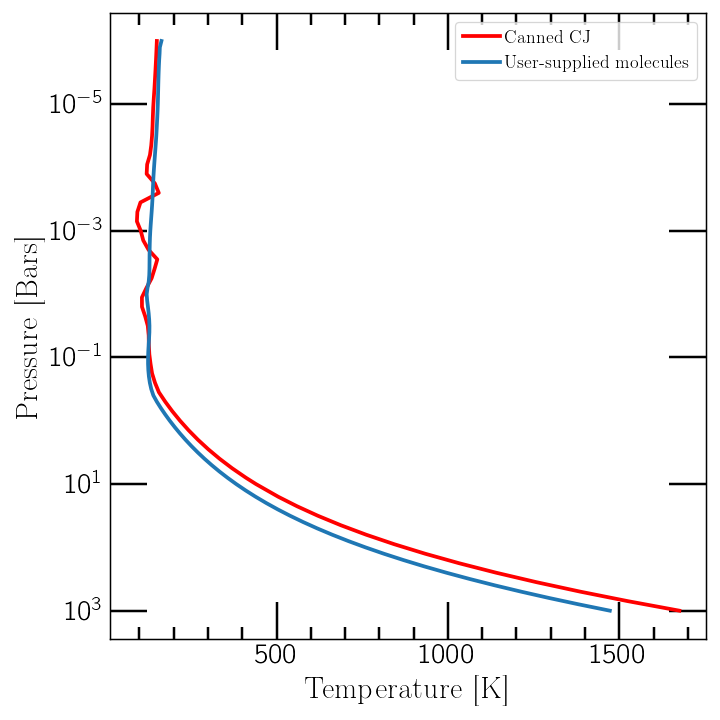

In [85]:
#### Plot PT profile:
plt.figure(figsize=(8,8))
plt.ylabel("Pressure [Bars]", fontsize=25)
plt.xlabel('Temperature [K]', fontsize=25)
plt.gca().invert_yaxis()
#plt.ylim(500,1e-4)
#plt.xlim(200,3000)
#plt.ylim(bottom=1e2)

plt.semilogy(cannedCJfull_output['level']['temperature'],
             cannedCJfull_output['level']['pressure'],color="r",linewidth=3,label="Canned CJ")



pl, noclouds, w_noclouds, f_noclouds, clouds, clouds_added, mols, clouds_spectrum, w_clouds, f_clouds = cj
df = clouds_spectrum
CJwno, CJalb, CJfull_output = df['wavenumber'] , df['albedo'] , df['full_output']
plt.semilogy(CJfull_output['level']['temperature'],
         CJfull_output['level']['pressure'],linewidth=3,label='User-supplied molecules')


plt.minorticks_on() 
plt.tick_params(axis='both',which='major',length =30, width=2,direction='in',labelsize=23)
plt.tick_params(axis='both',which='minor',length =10, width=2,direction='in',labelsize=23)

plt.legend(fontsize=15)

#plt.title(r"T$_{\rm eff}$= "+str(Teq)+" K, log(g)= "+\
##          str(np.round(cl_wj.inputs['planet']['gravity']/100, decimals=2))\
 #         +r" m s$^{-2}$",fontsize=25)

plt.tight_layout()

In [86]:
from virga import justdoit as vj 

# pressure temp profile from climate run:
temperature = clouds.inputs['atmosphere']['profile']['temperature']
pressure = clouds.inputs['atmosphere']['profile']['pressure']
metallicity = 1 #atmospheric metallicity relative to Solar
mean_molecular_weight = 2.2 # atmospheric mean molecular weight

#get virga recommendation for which gases to run
recommended = vj.recommend_gas(pressure, temperature, metallicity, mean_molecular_weight,
                #Turn on plotting
                 plot=True)
#print the results
print(recommended)

['H2O', 'KCl', 'NH3', 'Na2S', 'ZnS']


In [87]:
jpi.show(jpi.mixing_ratio(CJfull_output))

<IPython.core.display.Javascript object>


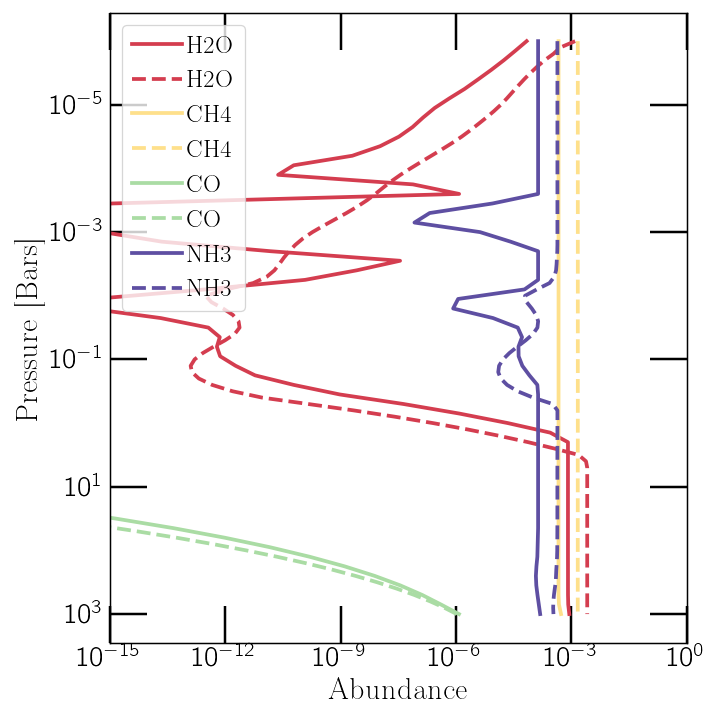

In [95]:
mols = ['H2O','CH4','CO','NH3']

#### Use 'ptchem_df' output from climate model, which contains the chemical structure of the
# computed climate.

%matplotlib notebook

import matplotlib

cmap = matplotlib.cm.get_cmap('Spectral')

n = len(mols)
cs = np.linspace(0.1,1,n)
colors = cmap(cs)

#colors = 

plt.figure(figsize=(8,8))
plt.minorticks_on()
plt.tick_params(axis='both',which='major',length =30, width=2,direction='in',labelsize=23)
plt.tick_params(axis='both',which='minor',length =10, width=2,direction='in',labelsize=23)

plt.ylabel("Pressure [Bars]", fontsize=25)
plt.xlabel('Abundance', fontsize=25)
plt.gca().invert_yaxis()
#plt.ylim(500,1e-4)
plt.xlim(left=1e-15)

for i,mol in enumerate(mols):
    plt.plot(cannedCJ.inputs['atmosphere']['profile'][mol],
             cannedCJ.inputs['atmosphere']['profile']['pressure'],
             color=colors[i],linewidth=3,label=mol)
    
    plt.plot(clouds.inputs['atmosphere']['profile'][mol],
             clouds.inputs['atmosphere']['profile']['pressure'],
             color=colors[i],linewidth=3,label=mol, ls='--')
plt.gca().set_yscale('log')
plt.gca().set_xscale('log')
#plt.gca().invert_yaxis()
plt.legend(fontsize=20)
plt.tight_layout()

<IPython.core.display.Javascript object>


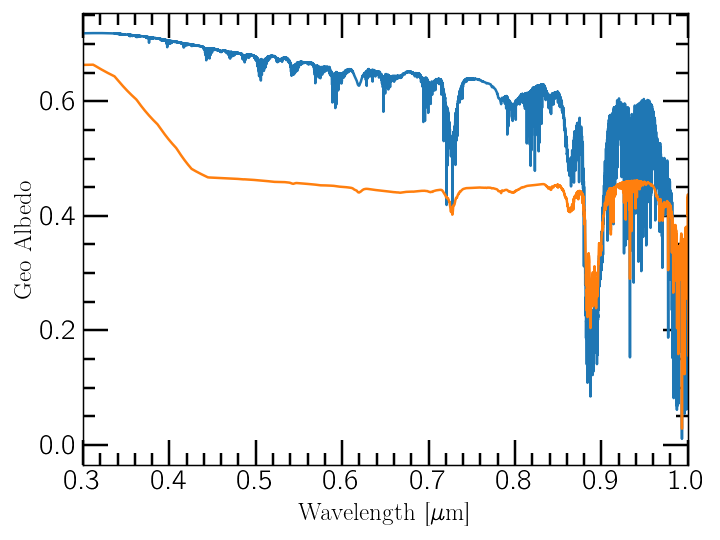

In [89]:
%matplotlib notebook

plt.figure(figsize=(8,6))
plt.minorticks_on()
plt.tick_params(axis='both',which='major',length =20, width=2,direction='in',labelsize=23)
plt.tick_params(axis='both',which='minor',length =10, width=2,direction='in',labelsize=23)

plt.plot(1e4/cannedCJwno, cannedCJalb, lw=2)
plt.plot(1e4/CJwno, CJalb, lw=2)

plt.xlim(0.3,1.0)
#plt.ylim(bottom = 1e-11)
#plt.gca().set_yscale('log')
plt.gca().set_xlabel(r'Wavelength [$\mu$m]')
plt.gca().set_ylabel('Geo Albedo')
plt.tight_layout()

# Fsed?

In [3]:
from myastrotools.tools import MakeModelPlanet
os.system('say "Starting Fsed"')

## Planet:
planettype = 'ColdJup'
tint = 100 # Internal Temperature of your Planet in K
Teq = 200 # planet equilibrium temperature 
radius = 1 #Rjup
msinij = 1
semi_major = 3


## Star:
T_star = 6000.0 # K, star effective temperature
logg = 4.437 #logg , cgs
metal = 0.0122 # metallicity of star
r_star = 0.8 # solar radius


## Climate:
nlevel = 91 # number of plane-parallel levels in your code
nofczns = 1 # number of convective zones initially. Let's not play with this for now.
nstr_upper = 85 # top most level of guessed convective zone
nstr_deep = nlevel -2 # this is always the case. Dont change this
nstr = np.array([0,nstr_upper,nstr_deep,0,0,0]) # initial guess of convective zones
rfacv = 0.5


semi_majors = np.array([0.5,3,5])


# cloud properties:
mean_molecular_weight = 2.2
fsed_models = []
fseds = np.array([0.01,0.1,0.3,1,3,6])
kz = 1e9

for fsed in fseds:
    print(fsed)
    ## Opacities:
    #planet_mh_str = '+200'#'+2' #log metallicity
    planet_mh_str = '+050'#'+2' #log metallicity
    planet_mh = float(planet_mh_str[1:])/100
    planet_mh_CtoO_str = '100'#'0.5' # CtoO ratio
    ck_db = f'/Volumes/Oy/picaso/reference/kcoeff_2020/sonora_2020_feh{planet_mh_str}_co_{planet_mh_CtoO_str}.data.196'
    opacity_ck = jdi.opannection(ck_db=ck_db)

    # save model params
    filename = f'{planettype}-Teq{Teq}-sep{semi_major}-mh{planet_mh_str}-co{planet_mh_CtoO_str}-fsed{fsed}-Tstar{T_star}-mmw{mean_molecular_weight}.nc'
    savefilename = '/Volumes/Oy/Reflected-Light-Ames/models/'+filename



    planet_properties = {
        'tint':tint, 'Teq':Teq, 'radius':radius, 'radius_unit':u.Rjup,
         'mass':msinij, 'mass_unit': u.Mjup,
         'gravity': None, 'gravity_unit':None,
        'semi_major':semi_major, 'semi_major_unit': u.AU,
        'mh': planet_mh, 'CtoO':planet_mh_CtoO_str
    }

    star_properties = {
        'Teff':T_star, 'logg':logg, 'mh':metal, 'radius':r_star
    }

    climate_run_setup = {
        'nlevel':nlevel, 'nofczns':nofczns, 'nstr_upper':nstr_upper,
        'nstr_deep':nstr_deep, 'rfacv':rfacv
    }

    cloud_properties = {
        'fsed':fsed, 'mean_mol_weight': mean_molecular_weight, 'kz':kz
    }


    cj_temp = MakeModelPlanet(planet_properties, 
                            star_properties, 
                            opacity_ck,
                            use_guillotpt = True,
                            compute_climate = True,
                            cdict = climate_run_setup,
                            climate_pbottom = 2,
                            climate_ptop = -6, 
                            clouddict = cloud_properties, 
                            spectrum_wavelength_range = [0.3,2.2],
                            spectrum_calculation = 'reflected',
                            spectrum_resolution = 150,
                            savemodel = True,
                            savefilename = savefilename
                 )
    fsed_models.append(cj_temp)
    
os.system('say "done"')
    


0.01
starting climate run
Iteration number  0 , min , max temp  172.4998246408363 664.6976603606946 , flux balance  21.697299610317224
Iteration number  1 , min , max temp  135.73133113110637 1114.6327521002693 , flux balance  6.134122346522835
Iteration number  2 , min , max temp  110.3446723715401 957.9048126971021 , flux balance  1.2873827882221682
Iteration number  3 , min , max temp  103.29044592590056 898.104168740372 , flux balance  0.1339966666518266
Iteration number  4 , min , max temp  102.88571125505709 890.6427058006377 , flux balance  0.0027896190853378836
Iteration number  5 , min , max temp  102.8838224973547 890.5323533642718 , flux balance  2.2880533656830375e-06
In t_start: Converged Solution in iterations  5
Big iteration is  102.8838224973547 0
Iteration number  0 , min , max temp  110.03758111695682 901.8567084995219 , flux balance  2.6622198869167897
Iteration number  1 , min , max temp  120.14461054285047 1077.6668385567098 , flux balance  1.2685697021578939
Iter

Iteration number  2 , min , max temp  119.47379537741274 1030.3421739123548 , flux balance  4.626101922578505e-08
In t_start: Converged Solution in iterations  2
Big iteration is  119.47379537741274 0
Iteration number  0 , min , max temp  119.63980116932655 1029.8864500029129 , flux balance  0.0034964478986095294
Iteration number  1 , min , max temp  119.64244102136006 1029.8859392744382 , flux balance  4.664724063009857e-05
Iteration number  2 , min , max temp  119.64249630948483 1029.885939162457 , flux balance  1.775001046597813e-08
In t_start: Converged Solution in iterations  2
Profile converged
Iteration number  0 , min , max temp  119.4009475497312 1011.9890340567271 , flux balance  0.0029045432211823982
Iteration number  1 , min , max temp  119.40164845837374 1011.9875029869135 , flux balance  0.00010273419780168006
Iteration number  2 , min , max temp  119.40158615090452 1011.9875024323948 , flux balance  3.1068893065177345e-07
In t_start: Converged Solution in iterations  2
B

Iteration number  0 , min , max temp  123.95361400216936 787.2130581748398 , flux balance  0.013926613371482443
Iteration number  1 , min , max temp  123.9250288307498 786.4307996173188 , flux balance  0.00024449228755160895
Iteration number  2 , min , max temp  123.92426006394446 786.4193113638385 , flux balance  2.5273827819324484e-06
In t_start: Converged Solution in iterations  2
Big iteration is  123.92426006394446 0
Iteration number  0 , min , max temp  121.79139321581475 792.0801775122259 , flux balance  0.003377705807478901
Iteration number  1 , min , max temp  120.90908044969832 792.050100389457 , flux balance  3.837105865330522e-05
 We are already at a root, tolf , test =  5e-05 ,  4.81243205058037e-05
Profile converged
Iteration number  0 , min , max temp  124.53023131980702 774.4472326025978 , flux balance  0.002337525498924613
Iteration number  1 , min , max temp  124.5329091332544 774.378627411023 , flux balance  6.41603959963671e-05
Iteration number  2 , min , max temp  

Iteration number  3 , min , max temp  120.53739380855836 1116.009335086491 , flux balance  0.0001363828848355774
Iteration number  4 , min , max temp  120.53732723078303 1116.0093347983081 , flux balance  8.316271614722513e-07
In t_start: Converged Solution in iterations  4
Big iteration is  120.53732723078303 3
Iteration number  0 , min , max temp  120.27491877777638 1120.6332048817208 , flux balance  0.11091615182122735
Iteration number  1 , min , max temp  120.09130621090928 1122.8539588571732 , flux balance  0.0059383304044077195
Iteration number  2 , min , max temp  120.08189609661991 1122.8438555265795 , flux balance  7.302226549077144e-05
Iteration number  3 , min , max temp  120.08188240079073 1122.8438528620068 , flux balance  5.6652984914252674e-08
In t_start: Converged Solution in iterations  3
Big iteration is  120.08188240079073 4
Iteration number  0 , min , max temp  120.0733571495655 1123.8824820369493 , flux balance  0.08768514126995482
Iteration number  1 , min , max t

Iteration number  0 , min , max temp  119.56228096567146 972.9646047070461 , flux balance  0.003544123322869223
Iteration number  1 , min , max temp  119.5649915495719 972.9645314076347 , flux balance  4.818695767850491e-05
Iteration number  2 , min , max temp  119.5650489951778 972.9645313602223 , flux balance  1.8785449174132858e-08
In t_start: Converged Solution in iterations  2
Big iteration is  119.5650489951778 0
Iteration number  0 , min , max temp  119.34023701396521 972.9119266416513 , flux balance  0.0029094144072521655
Iteration number  1 , min , max temp  119.34108797204591 972.9118976285706 , flux balance  0.0001057985874432776
Iteration number  2 , min , max temp  119.34102180882824 972.9118968529216 , flux balance  3.323927372951975e-07
In t_start: Converged Solution in iterations  2
Profile converged
Iteration number  0 , min , max temp  119.54796417389566 965.7974266150571 , flux balance  0.0038904813189028866
Iteration number  1 , min , max temp  119.55003683277235 96

Iteration number  0 , min , max temp  122.35898425354046 758.3958703001347 , flux balance  0.0017840278547924763
Iteration number  1 , min , max temp  121.22127607297469 758.4247814699003 , flux balance  1.8297060040681307e-05
 We are already at a root, tolf , test =  5e-05 ,  3.836397478394984e-05
Big iteration is  121.22127607297469 0
Iteration number  0 , min , max temp  125.09008555621566 759.1105382239022 , flux balance  0.0017265774109768508
Iteration number  1 , min , max temp  125.042264532043 759.1214945739907 , flux balance  2.717942260656897e-05
Iteration number  2 , min , max temp  125.04122074894765 759.1216787860601 , flux balance  -3.721463945295736e-08
In t_start: Converged Solution in iterations  2
Profile converged
final [ 0 64 89  0  0  0]
Iteration number  0 , min , max temp  124.23685345851528 759.255158256114 , flux balance  0.0025831246842909117
Iteration number  1 , min , max temp  123.32419444728585 759.2568022870147 , flux balance  2.426447846333676e-05
 We ar

Iteration number  0 , min , max temp  119.70737979420458 1073.7169521182527 , flux balance  0.0037926689070178874
Iteration number  1 , min , max temp  119.57694034184884 1073.7135665590436 , flux balance  6.920088906638131e-05
Iteration number  2 , min , max temp  119.54865155601539 1073.7135658679197 , flux balance  4.167231481981165e-08
In t_start: Converged Solution in iterations  2
Big iteration is  119.54865155601539 0
Iteration number  0 , min , max temp  119.51088602760942 1073.1353905548556 , flux balance  0.002819697168683191
Iteration number  1 , min , max temp  119.51194329440517 1073.1346891362846 , flux balance  9.059825290711492e-05
Iteration number  2 , min , max temp  119.51190848276417 1073.134688958664 , flux balance  2.441885186429657e-07
In t_start: Converged Solution in iterations  2
Profile converged
Iteration number  0 , min , max temp  119.59752973525926 1051.2386174838161 , flux balance  0.0038782089584059286
Iteration number  1 , min , max temp  119.598868305

Iteration number  2 , min , max temp  119.68924596438663 929.1462667881386 , flux balance  3.8703569431579644e-07
In t_start: Converged Solution in iterations  2
Big iteration is  119.68924596438663 0
Iteration number  0 , min , max temp  119.99034350839678 933.1752563272863 , flux balance  0.004668957030482431
Iteration number  1 , min , max temp  119.72618636423552 933.1243760512058 , flux balance  7.448780733702749e-05
Iteration number  2 , min , max temp  119.69469889031433 933.1243052267923 , flux balance  4.827108803201997e-08
In t_start: Converged Solution in iterations  2
Profile converged
Move up two levels
Iteration number  0 , min , max temp  121.61749676001165 818.6880575858097 , flux balance  -0.10537261655106041
Iteration number  1 , min , max temp  121.95544212972813 825.2447942891831 , flux balance  0.0015307619561842325
Iteration number  2 , min , max temp  121.95201144019293 825.1494044693743 , flux balance  1.1905415082223147e-05
In t_start: Converged Solution in ite

Big iteration is  111.47898831194054 2
Iteration number  0 , min , max temp  121.30685072052033 1098.5683824912028 , flux balance  0.30845268589505026
Iteration number  1 , min , max temp  120.67238400976272 1116.6721956000342 , flux balance  0.046315631434361466
Iteration number  2 , min , max temp  120.54016501873716 1116.0104502578113 , flux balance  0.0026629884450583394
Iteration number  3 , min , max temp  120.53739380855836 1116.009335086491 , flux balance  0.0001363828848355774
Iteration number  4 , min , max temp  120.53732723078303 1116.0093347983081 , flux balance  8.316271614722513e-07
In t_start: Converged Solution in iterations  4
Big iteration is  120.53732723078303 3
Iteration number  0 , min , max temp  120.27491877777638 1120.6332048817208 , flux balance  0.11091615182122735
Iteration number  1 , min , max temp  120.09130621090928 1122.8539588571732 , flux balance  0.0059383304044077195
Iteration number  2 , min , max temp  120.08189609661991 1122.8438555265795 , flux

Iteration number  0 , min , max temp  119.39817269423867 982.4127311298776 , flux balance  0.003468986328777698
Iteration number  1 , min , max temp  119.3992951965417 982.4125716410086 , flux balance  5.980619773227932e-05
Iteration number  2 , min , max temp  119.39929057030447 982.4125713658965 , flux balance  5.090063171806969e-08
In t_start: Converged Solution in iterations  2
Profile converged
Iteration number  0 , min , max temp  119.56228096567146 972.9646047070461 , flux balance  0.003544123322869223
Iteration number  1 , min , max temp  119.5649915495719 972.9645314076347 , flux balance  4.818695767850491e-05
Iteration number  2 , min , max temp  119.5650489951778 972.9645313602223 , flux balance  1.8785449174132858e-08
In t_start: Converged Solution in iterations  2
Big iteration is  119.5650489951778 0
Iteration number  0 , min , max temp  119.34023701396521 972.9119266416513 , flux balance  0.0029094144072521655
Iteration number  1 , min , max temp  119.34108797204591 972.

Iteration number  0 , min , max temp  124.9349740578968 760.9182187852484 , flux balance  0.0017057139779057123
Iteration number  1 , min , max temp  124.93722650796529 760.9309797966459 , flux balance  3.656371558620217e-05
Iteration number  2 , min , max temp  124.93724581353817 760.9311598489303 , flux balance  -1.241053131582753e-08
In t_start: Converged Solution in iterations  2
Profile converged
Iteration number  0 , min , max temp  122.35898425354046 758.3958703001347 , flux balance  0.0017840278547924763
Iteration number  1 , min , max temp  121.22127607297469 758.4247814699003 , flux balance  1.8297060040681307e-05
 We are already at a root, tolf , test =  5e-05 ,  3.836397478394984e-05
Big iteration is  121.22127607297469 0
Iteration number  0 , min , max temp  125.09008555621566 759.1105382239022 , flux balance  0.0017265774109768508
Iteration number  1 , min , max temp  125.042264532043 759.1214945739907 , flux balance  2.717942260656897e-05
Iteration number  2 , min , max 

Iteration number  0 , min , max temp  119.70737979420458 1073.7169521182527 , flux balance  0.0037926689070178874
Iteration number  1 , min , max temp  119.57694034184884 1073.7135665590436 , flux balance  6.920088906638131e-05
Iteration number  2 , min , max temp  119.54865155601539 1073.7135658679197 , flux balance  4.167231481981165e-08
In t_start: Converged Solution in iterations  2
Big iteration is  119.54865155601539 0
Iteration number  0 , min , max temp  119.51088602760942 1073.1353905548556 , flux balance  0.002819697168683191
Iteration number  1 , min , max temp  119.51194329440517 1073.1346891362846 , flux balance  9.059825290711492e-05
Iteration number  2 , min , max temp  119.51190848276417 1073.134688958664 , flux balance  2.441885186429657e-07
In t_start: Converged Solution in iterations  2
Profile converged
Iteration number  0 , min , max temp  119.59752973525926 1051.2386174838161 , flux balance  0.0038782089584059286
Iteration number  1 , min , max temp  119.598868305

Iteration number  2 , min , max temp  119.68924596438663 929.1462667881386 , flux balance  3.8703569431579644e-07
In t_start: Converged Solution in iterations  2
Big iteration is  119.68924596438663 0
Iteration number  0 , min , max temp  119.99034350839678 933.1752563272863 , flux balance  0.004668957030482431
Iteration number  1 , min , max temp  119.72618636423552 933.1243760512058 , flux balance  7.448780733702749e-05
Iteration number  2 , min , max temp  119.69469889031433 933.1243052267923 , flux balance  4.827108803201997e-08
In t_start: Converged Solution in iterations  2
Profile converged
Move up two levels
Iteration number  0 , min , max temp  121.61749676001165 818.6880575858097 , flux balance  -0.10537261655106041
Iteration number  1 , min , max temp  121.95544212972813 825.2447942891831 , flux balance  0.0015307619561842325
Iteration number  2 , min , max temp  121.95201144019293 825.1494044693743 , flux balance  1.1905415082223147e-05
In t_start: Converged Solution in ite

Iteration number  3 , min , max temp  111.52261905715086 1094.8653078817365 , flux balance  7.774575552393405e-05
Iteration number  4 , min , max temp  111.47898831194054 1094.865303197679 , flux balance  2.489116128560505e-08
In t_start: Converged Solution in iterations  4
Big iteration is  111.47898831194054 2
Iteration number  0 , min , max temp  121.30685072052033 1098.5683824912028 , flux balance  0.30845268589505026
Iteration number  1 , min , max temp  120.67238400976272 1116.6721956000342 , flux balance  0.046315631434361466
Iteration number  2 , min , max temp  120.54016501873716 1116.0104502578113 , flux balance  0.0026629884450583394
Iteration number  3 , min , max temp  120.53739380855836 1116.009335086491 , flux balance  0.0001363828848355774
Iteration number  4 , min , max temp  120.53732723078303 1116.0093347983081 , flux balance  8.316271614722513e-07
In t_start: Converged Solution in iterations  4
Big iteration is  120.53732723078303 3
Iteration number  0 , min , max t

Iteration number  0 , min , max temp  119.49847904530307 982.6079960958859 , flux balance  0.0030348722782842846
Iteration number  1 , min , max temp  119.50078242346581 982.6076304447799 , flux balance  3.811195237319661e-05
 We are already at a root, tolf , test =  5e-05 ,  4.563229124358854e-05
Big iteration is  119.50078242346581 0
Iteration number  0 , min , max temp  119.39817269423867 982.4127311298776 , flux balance  0.003468986328777698
Iteration number  1 , min , max temp  119.3992951965417 982.4125716410086 , flux balance  5.980619773227932e-05
Iteration number  2 , min , max temp  119.39929057030447 982.4125713658965 , flux balance  5.090063171806969e-08
In t_start: Converged Solution in iterations  2
Profile converged
Iteration number  0 , min , max temp  119.56228096567146 972.9646047070461 , flux balance  0.003544123322869223
Iteration number  1 , min , max temp  119.5649915495719 972.9645314076347 , flux balance  4.818695767850491e-05
Iteration number  2 , min , max tem

Iteration number  0 , min , max temp  122.58225474704659 759.9481509294174 , flux balance  0.0017410002126841647
Iteration number  1 , min , max temp  121.68471780787432 759.9592104126477 , flux balance  1.6858851032514273e-05
 We are already at a root, tolf , test =  5e-05 ,  2.1470428041847107e-05
Big iteration is  121.68471780787432 0
Iteration number  0 , min , max temp  124.9349740578968 760.9182187852484 , flux balance  0.0017057139779057123
Iteration number  1 , min , max temp  124.93722650796529 760.9309797966459 , flux balance  3.656371558620217e-05
Iteration number  2 , min , max temp  124.93724581353817 760.9311598489303 , flux balance  -1.241053131582753e-08
In t_start: Converged Solution in iterations  2
Profile converged
Iteration number  0 , min , max temp  122.35898425354046 758.3958703001347 , flux balance  0.0017840278547924763
Iteration number  1 , min , max temp  121.22127607297469 758.4247814699003 , flux balance  1.8297060040681307e-05
 We are already at a root, t

0

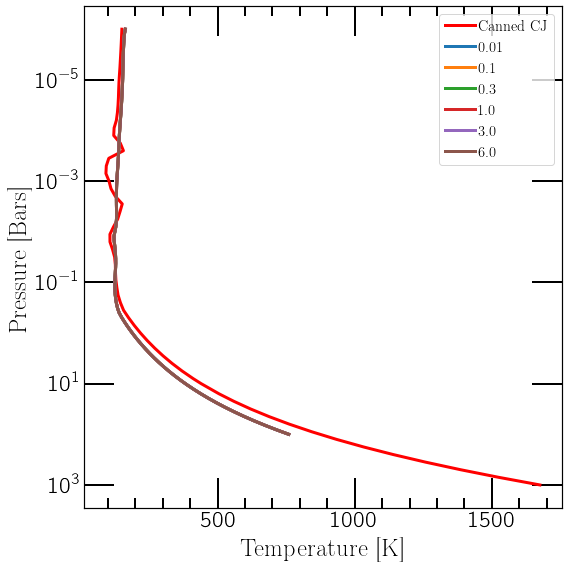

In [7]:
#### Plot PT profile:
plt.figure(figsize=(8,8))
plt.ylabel("Pressure [Bars]", fontsize=25)
plt.xlabel('Temperature [K]', fontsize=25)
plt.gca().invert_yaxis()
#plt.ylim(500,1e-4)
#plt.xlim(200,3000)
#plt.ylim(bottom=1e2)

plt.semilogy(cannedCJfull_output['level']['temperature'],
             cannedCJfull_output['level']['pressure'],color="r",linewidth=3,label="Canned CJ")


for i in range(len(fseds)):
    pl, noclouds, w_noclouds, f_noclouds, clouds, clouds_added, mols, clouds_spectrum, w_clouds, f_clouds = fsed_models[i]

    df = clouds_spectrum
    CJwno, CJalb, CJfull_output = df['wavenumber'] , df['albedo'] , df['full_output'] 

    plt.semilogy(CJfull_output['level']['temperature'],
             CJfull_output['level']['pressure'],linewidth=3,label=fseds[i])

plt.minorticks_on() 
plt.tick_params(axis='both',which='major',length =30, width=2,direction='in',labelsize=23)
plt.tick_params(axis='both',which='minor',length =10, width=2,direction='in',labelsize=23)

plt.legend(fontsize=15)

#plt.title(r"T$_{\rm eff}$= "+str(Teq)+" K, log(g)= "+\
##          str(np.round(cl_wj.inputs['planet']['gravity']/100, decimals=2))\
 #         +r" m s$^{-2}$",fontsize=25)

plt.tight_layout()

## Metallicity?

In [4]:
from myastrotools.tools import MakeModelPlanet

## Planet:
planettype = 'ColdJup'
tint = 100 # Internal Temperature of your Planet in K
Teq = 200 # planet equilibrium temperature 
radius = 1 #Rjup
msinij = 1
semi_major = 3


## Star:
T_star = 6000.0 # K, star effective temperature
logg = 4.437 #logg , cgs
metal = 0.0122 # metallicity of star
r_star = 0.8 # solar radius


## Climate:
nlevel = 91 # number of plane-parallel levels in your code
nofczns = 1 # number of convective zones initially. Let's not play with this for now.
nstr_upper = 85 # top most level of guessed convective zone
nstr_deep = nlevel -2 # this is always the case. Dont change this
nstr = np.array([0,nstr_upper,nstr_deep,0,0,0]) # initial guess of convective zones
rfacv = 0.5


# cloud properties:
mean_molecular_weight = 2.2
fsed = 1
kz = 1e9

mh_models = []
mhs_used = []
mhs = ['-050','-100','+000','+050','+100','+200']
planet_mh_CtoO_str = '100'#'0.5' # CtoO ratio

for planet_mh_str in mhs:
    try:
        print(planet_mh_str)
        planet_mh = float(planet_mh_str[1:])/100
        ck_db = f'/Volumes/Oy/picaso/reference/kcoeff_2020/sonora_2020_feh{planet_mh_str}_co_{planet_mh_CtoO_str}.data.196'
        opacity_ck = jdi.opannection(ck_db=ck_db)

        # save model params
        filename = f'{planettype}-Teq{Teq}-sep{semi_major}-mh{planet_mh_str}-co{planet_mh_CtoO_str}-fsed{fsed}-Tstar{T_star}-mmw{mean_molecular_weight}.nc'
        savefilename = '/Volumes/Oy/Reflected-Light-Ames/models/'+filename



        planet_properties = {
            'tint':tint, 'Teq':Teq, 'radius':radius, 'radius_unit':u.Rjup,
             'mass':msinij, 'mass_unit': u.Mjup,
             'gravity': None, 'gravity_unit':None,
            'semi_major':semi_major, 'semi_major_unit': u.AU,
            'mh': planet_mh, 'CtoO':planet_mh_CtoO_str
        }

        star_properties = {
            'Teff':T_star, 'logg':logg, 'mh':metal, 'radius':r_star
        }

        climate_run_setup = {
            'nlevel':nlevel, 'nofczns':nofczns, 'nstr_upper':nstr_upper,
            'nstr_deep':nstr_deep, 'rfacv':rfacv
        }

        cloud_properties = {
            'fsed':fsed, 'mean_mol_weight': mean_molecular_weight, 'kz':kz
        }


        cj_temp = MakeModelPlanet(planet_properties, 
                                star_properties, 
                                opacity_ck,
                                use_guillotpt = True,
                                compute_climate = True,
                                cdict = climate_run_setup,
                                climate_pbottom = 2,
                                climate_ptop = -6, 
                                clouddict = cloud_properties, 
                                spectrum_wavelength_range = [0.3,2.2],
                                spectrum_calculation = 'reflected',
                                spectrum_resolution = 150,
                                savemodel = True,
                                savefilename = savefilename
                     )
        mh_models.append(cj_temp)
        mhs_used.append(planet_mh_str)
    except:
        pass




-050
starting climate run
Iteration number  0 , min , max temp  166.93916537406773 631.7831556890545 , flux balance  26.940347820816562
Iteration number  1 , min , max temp  121.66303372307739 688.0539504858384 , flux balance  7.64283965846944
Iteration number  2 , min , max temp  93.89154625571469 679.1253281112245 , flux balance  1.7826606840753902
Iteration number  3 , min , max temp  85.60870246290713 678.8590220973335 , flux balance  0.24035929918244547
Iteration number  4 , min , max temp  84.88496515250243 678.8594121047096 , flux balance  0.008060706179925131
Iteration number  5 , min , max temp  84.87830668945467 678.8594275822426 , flux balance  1.4227344664053814e-05
In t_start: Converged Solution in iterations  5
Big iteration is  84.87830668945467 0
Iteration number  0 , min , max temp  85.43585992636291 678.8984776678968 , flux balance  1.8504636478296295
Iteration number  1 , min , max temp  96.23576150583249 680.4747723072408 , flux balance  1.7642762164899666
Iteration

Iteration number  0 , min , max temp  109.46791228845083 695.6543132185686 , flux balance  0.0025460874071984566
Iteration number  1 , min , max temp  104.52972132566386 695.6542261094338 , flux balance  0.0003126986553159756
Iteration number  2 , min , max temp  104.12974997379338 695.6542260337349 , flux balance  2.0445893435531344e-06
 We are already at a root, tolf , test =  5e-05 ,  2.061787947245689e-06
Big iteration is  104.12974997379338 4
Not converged
 convection zone status
0 84 89 0 0 0
1
[ 0 73 73 73 84 89]
Iteration number  0 , min , max temp  110.64353301454494 695.6421878779854 , flux balance  -5.3614911056866455e-05
Iteration number  1 , min , max temp  110.57400752491945 695.6349884852445 , flux balance  0.00015947414703918315
Iteration number  2 , min , max temp  110.57388299963176 695.6350019706198 , flux balance  2.2566727601912839e-07
In t_start: Converged Solution in iterations  2
Big iteration is  110.57388299963176 0
Iteration number  0 , min , max temp  107.42

Iteration number  2 , min , max temp  106.2064041916875 690.4365277981448 , flux balance  5.873829280762306e-07
 We are already at a root, tolf , test =  5e-05 ,  2.7428724611927474e-06
Profile converged
[ 0 67 76 76 84 89]
Iteration number  0 , min , max temp  112.70478812068642 690.2225141684492 , flux balance  -0.03323596164690043
Iteration number  1 , min , max temp  108.24386358639869 689.9952217136342 , flux balance  0.0006751930019498059
Iteration number  2 , min , max temp  107.90755239586287 689.993401372191 , flux balance  -2.6532022825054282e-06
 We are already at a root, tolf , test =  5e-05 ,  2.183583692619506e-05
Big iteration is  107.90755239586287 0
Iteration number  0 , min , max temp  113.72453583603978 689.8795209847528 , flux balance  -0.006508552586295692
Iteration number  1 , min , max temp  108.63730740525445 689.8158903351691 , flux balance  0.00010508970065258383
Iteration number  2 , min , max temp  107.87551901038678 689.8155133943319 , flux balance  -1.1739

adding clouds
virga recommended gas species: ['H2O', 'NH3']
-100
starting climate run
Iteration number  0 , min , max temp  166.3575587386641 620.8069268613837 , flux balance  31.515962062360824
Iteration number  1 , min , max temp  115.77405624141349 630.263546232297 , flux balance  9.094045838914877
Iteration number  2 , min , max temp  85.69949598953305 630.3227699811656 , flux balance  2.239327352836694
Iteration number  3 , min , max temp  78.75514892881662 630.3551799183659 , flux balance  0.3507877519070326
Iteration number  4 , min , max temp  77.76973045292863 630.3564430275769 , flux balance  0.016534068783814786
Iteration number  5 , min , max temp  77.75590351154635 630.3564751679521 , flux balance  5.586654060788842e-05
Iteration number  6 , min , max temp  77.75620936523156 630.356475253336 , flux balance  2.498759610609342e-07
In t_start: Converged Solution in iterations  6
Big iteration is  77.75620936523156 0
Iteration number  0 , min , max temp  78.24903333157906 630.

Iteration number  0 , min , max temp  98.78182714422809 761.1551035269129 , flux balance  2.210094035740077
Iteration number  1 , min , max temp  115.66884248643089 821.8338800384515 , flux balance  2.827442196294365
Iteration number  2 , min , max temp  71.88786218328757 814.1650890192756 , flux balance  0.7641778935911085
Iteration number  3 , min , max temp  52.6 814.024338782116 , flux balance  0.223523465198333
Iteration number  4 , min , max temp  107.06636519831227 814.024326922179 , flux balance  0.2019778727411883
Iteration number  5 , min , max temp  52.6 814.0242193480049 , flux balance  0.25937352384043655
Iteration number  6 , min , max temp  52.6 814.0245686026782 , flux balance  0.07420321419460724
Iteration number  7 , min , max temp  52.6 814.024397821031 , flux balance  0.03151079916167309
Iteration number  8 , min , max temp  52.6 814.0242723389011 , flux balance  0.010017850021128672
Iteration number  9 , min , max temp  98.86389224997492 814.0242658531046 , flux ba

Iteration number  0 , min , max temp  52.6 5199.903173601517 , flux balance  -0.06935236165549523
In t_start: Converged Solution in iterations  0
1  points went off the opacity grid. Correcting those.
Profile converged
[ 0 70 73 73 80 89]
Iteration number  0 , min , max temp  52.6 5199.903513351244 , flux balance  -0.005347626179302826
In t_start: Converged Solution in iterations  0
1  points went off the opacity grid. Correcting those.
Big iteration is  52.6 0
Iteration number  0 , min , max temp  52.6 5199.903844227826 , flux balance  -0.009309687462055216
In t_start: Converged Solution in iterations  0
1  points went off the opacity grid. Correcting those.
Profile converged
[ 0 69 73 73 80 89]
Iteration number  0 , min , max temp  52.6 5199.90392979009 , flux balance  0.05064204476422482
In t_start: Converged Solution in iterations  0
1  points went off the opacity grid. Correcting those.
Big iteration is  52.6 0
Iteration number  0 , min , max temp  52.6 5199.904260436985 , flux ba

+050
starting climate run
Iteration number  0 , min , max temp  172.4998246408363 664.6976603606946 , flux balance  21.697299610317224
Iteration number  1 , min , max temp  135.73133113110637 1114.6327521002693 , flux balance  6.134122346522835
Iteration number  2 , min , max temp  110.3446723715401 957.9048126971021 , flux balance  1.2873827882221682
Iteration number  3 , min , max temp  103.29044592590056 898.104168740372 , flux balance  0.1339966666518266
Iteration number  4 , min , max temp  102.88571125505709 890.6427058006377 , flux balance  0.0027896190853378836
Iteration number  5 , min , max temp  102.8838224973547 890.5323533642718 , flux balance  2.2880533656830375e-06
In t_start: Converged Solution in iterations  5
Big iteration is  102.8838224973547 0
Iteration number  0 , min , max temp  110.03758111695682 901.8567084995219 , flux balance  2.6622198869167897
Iteration number  1 , min , max temp  120.14461054285047 1077.6668385567098 , flux balance  1.2685697021578939
Iter

Iteration number  2 , min , max temp  119.47379537741274 1030.3421739123548 , flux balance  4.626101922578505e-08
In t_start: Converged Solution in iterations  2
Big iteration is  119.47379537741274 0
Iteration number  0 , min , max temp  119.63980116932655 1029.8864500029129 , flux balance  0.0034964478986095294
Iteration number  1 , min , max temp  119.64244102136006 1029.8859392744382 , flux balance  4.664724063009857e-05
Iteration number  2 , min , max temp  119.64249630948483 1029.885939162457 , flux balance  1.775001046597813e-08
In t_start: Converged Solution in iterations  2
Profile converged
Iteration number  0 , min , max temp  119.4009475497312 1011.9890340567271 , flux balance  0.0029045432211823982
Iteration number  1 , min , max temp  119.40164845837374 1011.9875029869135 , flux balance  0.00010273419780168006
Iteration number  2 , min , max temp  119.40158615090452 1011.9875024323948 , flux balance  3.1068893065177345e-07
In t_start: Converged Solution in iterations  2
B

Iteration number  0 , min , max temp  123.95361400216936 787.2130581748398 , flux balance  0.013926613371482443
Iteration number  1 , min , max temp  123.9250288307498 786.4307996173188 , flux balance  0.00024449228755160895
Iteration number  2 , min , max temp  123.92426006394446 786.4193113638385 , flux balance  2.5273827819324484e-06
In t_start: Converged Solution in iterations  2
Big iteration is  123.92426006394446 0
Iteration number  0 , min , max temp  121.79139321581475 792.0801775122259 , flux balance  0.003377705807478901
Iteration number  1 , min , max temp  120.90908044969832 792.050100389457 , flux balance  3.837105865330522e-05
 We are already at a root, tolf , test =  5e-05 ,  4.81243205058037e-05
Profile converged
Iteration number  0 , min , max temp  124.53023131980702 774.4472326025978 , flux balance  0.002337525498924613
Iteration number  1 , min , max temp  124.5329091332544 774.378627411023 , flux balance  6.41603959963671e-05
Iteration number  2 , min , max temp  

Iteration number  0 , min , max temp  123.75193586492554 1344.9367407641018 , flux balance  0.01016035497806632
Iteration number  1 , min , max temp  123.7266123577822 1344.937300377323 , flux balance  2.8003055049697415e-05
In t_start: Converged Solution in iterations  1
Big iteration is  123.7266123577822 0
Iteration number  0 , min , max temp  123.65713134552571 1344.678505443003 , flux balance  0.003506940457070208
Iteration number  1 , min , max temp  123.65101320880781 1344.6783751128712 , flux balance  4.4697438115533695e-06
In t_start: Converged Solution in iterations  1
Profile converged
Grow Phase : Upper Zone
[ 0 79 80 80 85 89]
Iteration number  0 , min , max temp  123.52097342664858 1341.0424276817532 , flux balance  0.0019560298308623986
Iteration number  1 , min , max temp  123.51768244377296 1341.007813621951 , flux balance  1.7417028206144462e-06
In t_start: Converged Solution in iterations  1
Big iteration is  123.51768244377296 0
Iteration number  0 , min , max temp 

Iteration number  0 , min , max temp  127.17607647262685 860.8958747482421 , flux balance  0.019805983361705064
Iteration number  1 , min , max temp  127.10665610523054 859.3070535579744 , flux balance  0.00019180304888674968
In t_start: Converged Solution in iterations  1
Big iteration is  127.10665610523054 0
Iteration number  0 , min , max temp  127.46612336797953 872.9917645515796 , flux balance  0.004412716863299047
Iteration number  1 , min , max temp  127.45217365624933 872.5753542271985 , flux balance  2.804303712861108e-05
In t_start: Converged Solution in iterations  1
Profile converged
[ 0 68 89  0 85 89]
Iteration number  0 , min , max temp  127.84270670643812 823.7289197797477 , flux balance  0.002858895309922354
Iteration number  1 , min , max temp  127.83422268970043 823.4448609491797 , flux balance  3.291644196113789e-05
In t_start: Converged Solution in iterations  1
Big iteration is  127.83422268970043 0
Iteration number  0 , min , max temp  128.03701097430792 827.946

Iteration number  0 , min , max temp  127.84081773385334 1630.1899857038645 , flux balance  0.1721922293679314
Iteration number  1 , min , max temp  127.19224779826419 1630.1909404191892 , flux balance  0.0046549227953378396
Iteration number  2 , min , max temp  127.17545914540472 1630.1909521639682 , flux balance  9.40149818854166e-06
In t_start: Converged Solution in iterations  2
Big iteration is  127.17545914540472 0
Iteration number  0 , min , max temp  126.8893729734403 1630.093920654166 , flux balance  0.20775082012685644
Iteration number  1 , min , max temp  126.69837230403894 1630.0944759105232 , flux balance  0.009588119302141295
Iteration number  2 , min , max temp  126.68984620311096 1630.0944875626144 , flux balance  3.0423653489127398e-05
In t_start: Converged Solution in iterations  2
Profile converged
Grow Phase : Upper Zone
[ 0 74 75 75 85 89]
Iteration number  0 , min , max temp  126.1215467172799 1628.5222117191836 , flux balance  0.2551525111246892
Iteration number 

Big iteration is  128.91187054123006 0
Iteration number  0 , min , max temp  128.26524231849837 1602.316586523036 , flux balance  0.011807024516129036
Iteration number  1 , min , max temp  128.1921506379735 1602.379890799456 , flux balance  8.311346468047627e-05
Iteration number  2 , min , max temp  128.19203417042243 1602.3799308615914 , flux balance  4.3296044998844995e-08
In t_start: Converged Solution in iterations  2
Profile converged
[ 0 69 78 78 85 89]
Iteration number  0 , min , max temp  128.27628463908357 1601.0971261586672 , flux balance  0.08146264547997495
Iteration number  1 , min , max temp  128.8613048623886 1592.151221808189 , flux balance  0.01528843428268624
Iteration number  2 , min , max temp  128.84786855150097 1591.919356023156 , flux balance  0.0007708283176532805
Iteration number  3 , min , max temp  128.8447488103945 1592.4515332571475 , flux balance  1.7514816141265615e-05
In t_start: Converged Solution in iterations  3
Big iteration is  128.8447488103945 0
I

Profile converged
[ 0 65 89  0 85 89]
Iteration number  0 , min , max temp  130.04343129622146 760.4496221626356 , flux balance  0.0004306275900819015
Iteration number  1 , min , max temp  130.0447412045007 760.3600051841153 , flux balance  9.44414000943953e-06
In t_start: Converged Solution in iterations  1
Big iteration is  130.0447412045007 0
Iteration number  0 , min , max temp  130.20574417302498 762.8097886679669 , flux balance  -6.604886355247844e-05
Iteration number  1 , min , max temp  130.20655236953928 762.8130388825916 , flux balance  -3.1892761841836514e-07
In t_start: Converged Solution in iterations  1
Profile converged
[ 0 64 89  0 85 89]
Iteration number  0 , min , max temp  130.14918002995128 758.352316580379 , flux balance  -0.0001167611992762222
Iteration number  1 , min , max temp  130.1511033328362 758.3497238159655 , flux balance  3.0495612115495934e-07
In t_start: Converged Solution in iterations  1
Big iteration is  130.1511033328362 0
Iteration number  0 , min

In [5]:
os.system('say "Done"')

0

In [6]:
mhs_used

['-050', '+000', '+050', '+100', '+200']

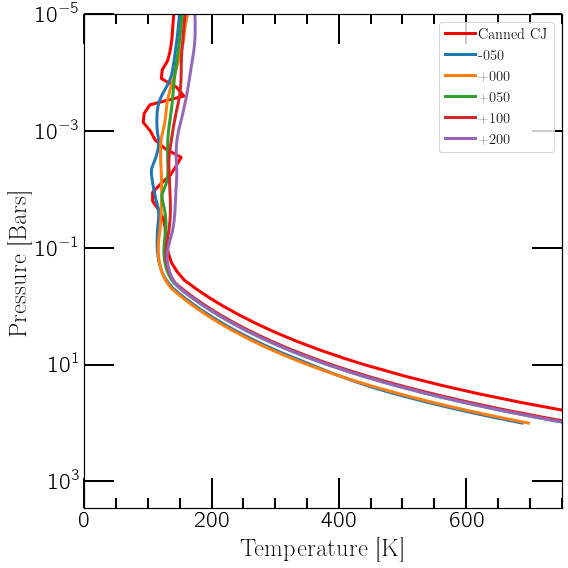

In [14]:
#### Plot PT profile:
plt.figure(figsize=(8,8))
plt.ylabel("Pressure [Bars]", fontsize=25)
plt.xlabel('Temperature [K]', fontsize=25)
plt.gca().invert_yaxis()
#plt.ylim(500,1e-4)
#plt.xlim(200,3000)
#plt.ylim(bottom=1e2)

plt.semilogy(cannedCJfull_output['level']['temperature'],
             cannedCJfull_output['level']['pressure'],color="r",linewidth=3,label="Canned CJ")


for i in range(len(mhs_used)):
    pl, noclouds, w_noclouds, f_noclouds, clouds, clouds_added, mols, clouds_spectrum, w_clouds, f_clouds = mh_models[i]

    df = clouds_spectrum
    CJwno, CJalb, CJfull_output = df['wavenumber'] , df['albedo'] , df['full_output'] 

    plt.semilogy(CJfull_output['level']['temperature'],
             CJfull_output['level']['pressure'],linewidth=3,label=mhs_used[i])

plt.minorticks_on() 
plt.tick_params(axis='both',which='major',length =30, width=2,direction='in',labelsize=23)
plt.tick_params(axis='both',which='minor',length =10, width=2,direction='in',labelsize=23)

plt.legend(fontsize=15)

#plt.title(r"T$_{\rm eff}$= "+str(Teq)+" K, log(g)= "+\
##          str(np.round(cl_wj.inputs['planet']['gravity']/100, decimals=2))\
 #         +r" m s$^{-2}$",fontsize=25)
plt.xlim(right=750, left=0)
plt.ylim(top=1e-5)

plt.tight_layout()

## MMW?

In [ ]:
from myastrotools.tools import MakeModelPlanet

## Planet:
planettype = 'ColdJup'
tint = 100 # Internal Temperature of your Planet in K
Teq = 200 # planet equilibrium temperature 
radius = 1 #Rjup
msinij = 1
semi_major = 3


## Star:
T_star = 6000.0 # K, star effective temperature
logg = 4.437 #logg , cgs
metal = 0.0122 # metallicity of star
r_star = 0.8 # solar radius


## Climate:
nlevel = 91 # number of plane-parallel levels in your code
nofczns = 1 # number of convective zones initially. Let's not play with this for now.
nstr_upper = 85 # top most level of guessed convective zone
nstr_deep = nlevel -2 # this is always the case. Dont change this
nstr = np.array([0,nstr_upper,nstr_deep,0,0,0]) # initial guess of convective zones
rfacv = 0.5


# cloud properties:
mean_molecular_weights = np.array([1,2.0,3,5,10])
mmws_used = []
fsed = 1
kz = 1e9

mmw_models = []

planet_mh_CtoO_str = '100'#'0.5' # CtoO ratio

for mean_molecular_weight in mean_molecular_weights:
    try:
        print(planet_mh_str)
        planet_mh_str = '+050'#'+2' #log metallicity
        ck_db = f'/Volumes/Oy/picaso/reference/kcoeff_2020/sonora_2020_feh{planet_mh_str}_co_{planet_mh_CtoO_str}.data.196'
        opacity_ck = jdi.opannection(ck_db=ck_db)

        # save model params
        filename = f'{planettype}-Teq{Teq}-sep{semi_major}-mh{planet_mh_str}-co{planet_mh_CtoO_str}-fsed{fsed}-Tstar{T_star}-mmw{mean_molecular_weight}.nc'
        savefilename = '/Volumes/Oy/Reflected-Light-Ames/models/'+filename



        planet_properties = {
            'tint':tint, 'Teq':Teq, 'radius':radius, 'radius_unit':u.Rjup,
             'mass':msinij, 'mass_unit': u.Mjup,
             'gravity': None, 'gravity_unit':None,
            'semi_major':semi_major, 'semi_major_unit': u.AU,
            'mh': planet_mh, 'CtoO':planet_mh_CtoO_str
        }

        star_properties = {
            'Teff':T_star, 'logg':logg, 'mh':metal, 'radius':r_star
        }

        climate_run_setup = {
            'nlevel':nlevel, 'nofczns':nofczns, 'nstr_upper':nstr_upper,
            'nstr_deep':nstr_deep, 'rfacv':rfacv
        }

        cloud_properties = {
            'fsed':fsed, 'mean_mol_weight': mean_molecular_weight, 'kz':kz
        }


        cj_temp = MakeModelPlanet(planet_properties, 
                                star_properties, 
                                opacity_ck,
                                use_guillotpt = True,
                                compute_climate = True,
                                cdict = climate_run_setup,
                                climate_pbottom = 2,
                                climate_ptop = -6, 
                                clouddict = cloud_properties, 
                                spectrum_wavelength_range = [0.3,2.2],
                                spectrum_calculation = 'reflected',
                                spectrum_resolution = 150,
                                savemodel = True,
                                savefilename = savefilename
                     )
        mmw_models.append(cj_temp)
        mmws_used.append(mean_molecular_weight)
    except:
        pass

